# Odszumianie - implementacja metod spatial filtering i frequency filtering - Karolina Jeziorska i Oskar Bujacz - Seminarium: Algorytmy numeryczne i graficzne

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

params = {"ytick.color" : "c",
          "xtick.color" : "c",
          "axes.labelcolor" : "c",
          "axes.edgecolor" : "c",
         "text.color" : "c"}
plt.rcParams.update(params)
import random
import math
from copy import deepcopy
import cv2

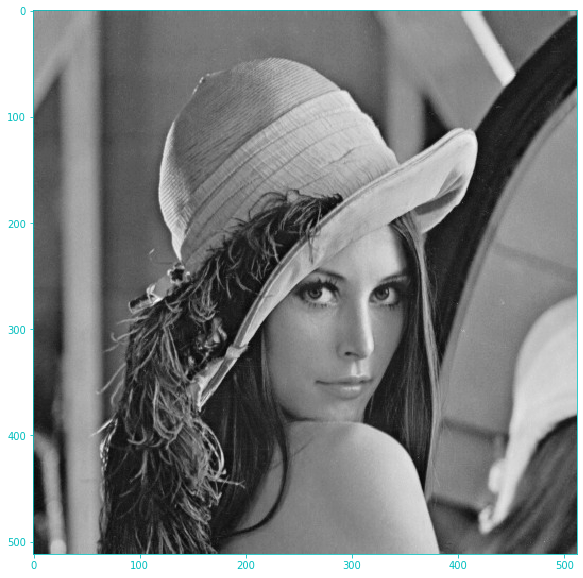

In [17]:
#Load the image
plt.figure(figsize = (10,10))
img = cv2.imread('lena_gray.jpg',cv2.IMREAD_GRAYSCALE)
plt.imshow(img, cmap='gray') 

## Kilka ocen jakości odszumiania

In [2]:
def snr(oryg, mod):
    oryg = oryg.astype('int64') 
    mod = mod.astype('int64') 
    a = np.sum(np.square(mod))
    b = np.sum(np.square(np.subtract(mod, oryg)))
    return a/b

In [3]:
def psnr(oryg, mod):
    oryg = oryg.astype('int64') 
    mod = mod.astype('int64') 
    a = np.max(mod)
    b = np.sum(np.square(np.subtract(mod, oryg)))/(oryg.shape[0]*oryg.shape[1])
    return (a*a)/b

In [4]:
def rmse(oryg, mod):
    oryg = oryg.astype('int64') 
    mod = mod.astype('int64') 
    return np.sqrt(np.sum(np.square(np.subtract(mod, oryg)))/(oryg.shape[0]*oryg.shape[1]))

## Dodawanie szumu

In [5]:
def add_gaussian(img, sigma):
    gaussian_noise = np.random.normal(0, sigma, img.shape)
    gaussian_noise = gaussian_noise.reshape(img.shape)
    noisy_image = img + gaussian_noise
    noisy_image = np.clip(noisy_image, 0, 255)
    noisy_image = noisy_image.astype(np.uint8)
    return noisy_image
    
def add_salt_pepper(img, perc):
    x, y = img.shape
    img2 = deepcopy(img)
    for i in range(0,x):
        for j in range(0,y):
            val = random.random()
            if val < (perc/100):                
                img2[i,j] = random.choice((np.uint8(0), np.uint8(255)))
    img2 = np.clip(img2, 0, 255)
    img2 = img2.astype(np.uint8)
    return img2

In [6]:
def decybel(val):
    return 10*math.log(val, 10)
def add_noise(fun, val):
    img2 = fun(img, val)
    fix, ax = plt.subplots(1,2)
    fix.set_size_inches(20,10)
    ax[0].imshow(img, cmap='gray') 
    ax[1].imshow(img2, cmap='gray') 
    print("RMSE: ", rmse(img, img2))
    print("SNR: ",decybel(snr(img, img2)))
    print("PSNR: ",decybel(psnr(img, img2)))
    return img2

# Obrazy z dodanym szumem

RMSE:  13.639050719489557
SNR:  19.820980143097906
PSNR:  25.435120720794927


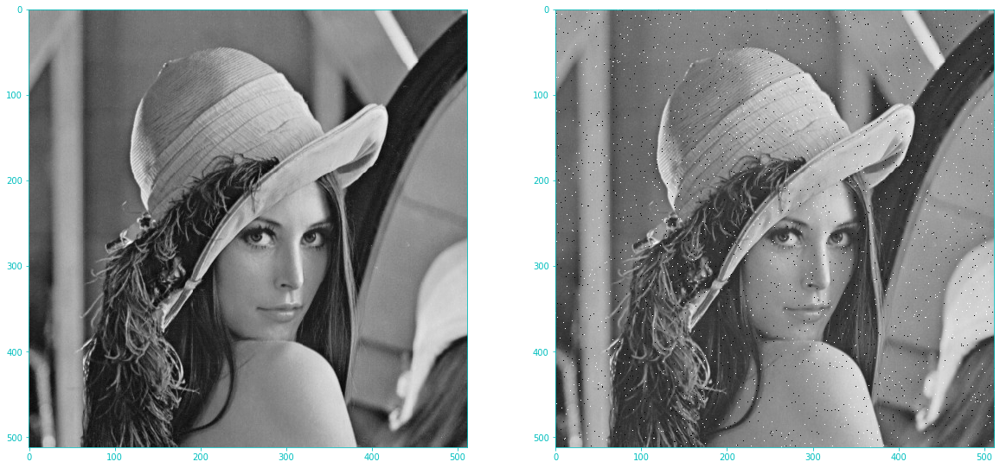

In [18]:
img_salt_pepper_1 = add_noise(add_salt_pepper, 1)

RMSE:  30.256857417895944
SNR:  13.0371087454938
PSNR:  18.514327234698477


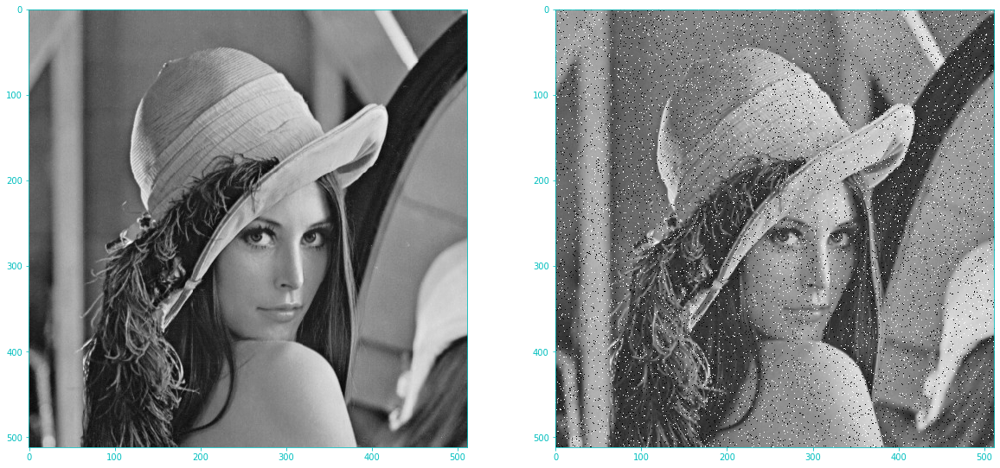

In [19]:
img_salt_pepper_5 = add_noise(add_salt_pepper, 5)

RMSE:  60.5531151963237
SNR:  7.512893848815771
PSNR:  12.48807379608461


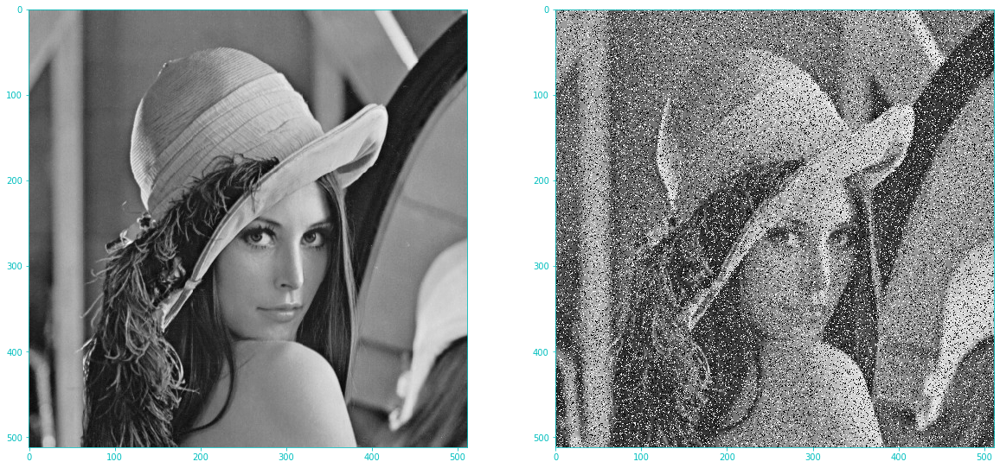

In [20]:
img_salt_pepper_20 = add_noise(add_salt_pepper, 20)

RMSE:  85.46803464712202
SNR:  5.086605244211164
PSNR:  9.494729260799346


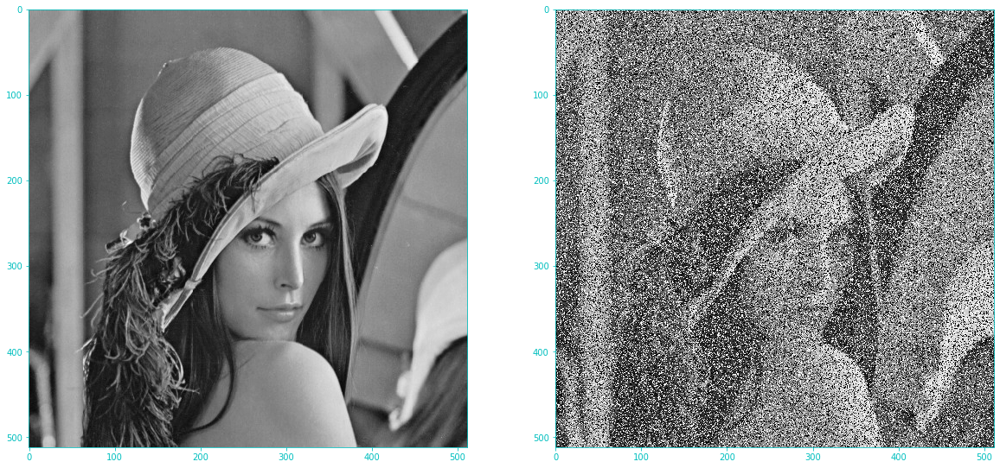

In [21]:
img_salt_pepper_40 = add_noise(add_salt_pepper, 40)

RMSE:  5.052462198530349
SNR:  28.387320490263086
PSNR:  34.06074215070601


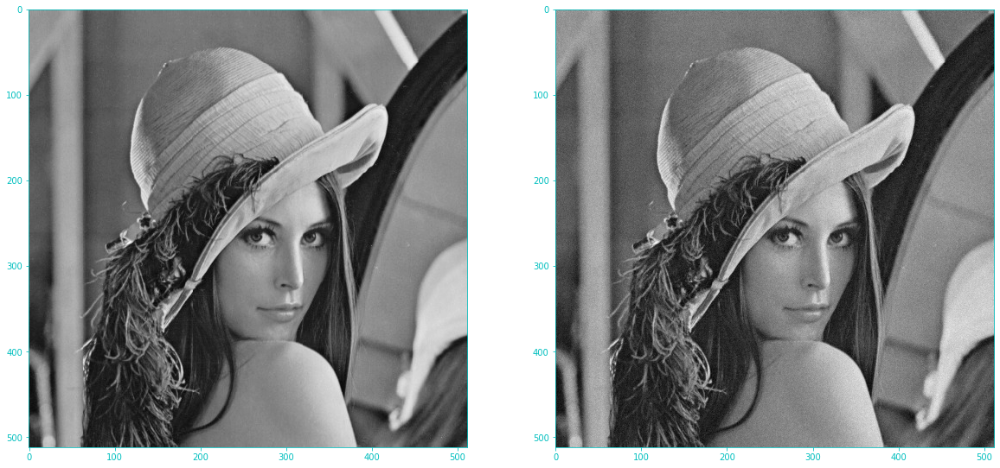

In [22]:
img_gauss_5 = add_noise(add_gaussian,5)

RMSE:  10.034039166062886
SNR:  22.446657662183796
PSNR:  28.10128777097402


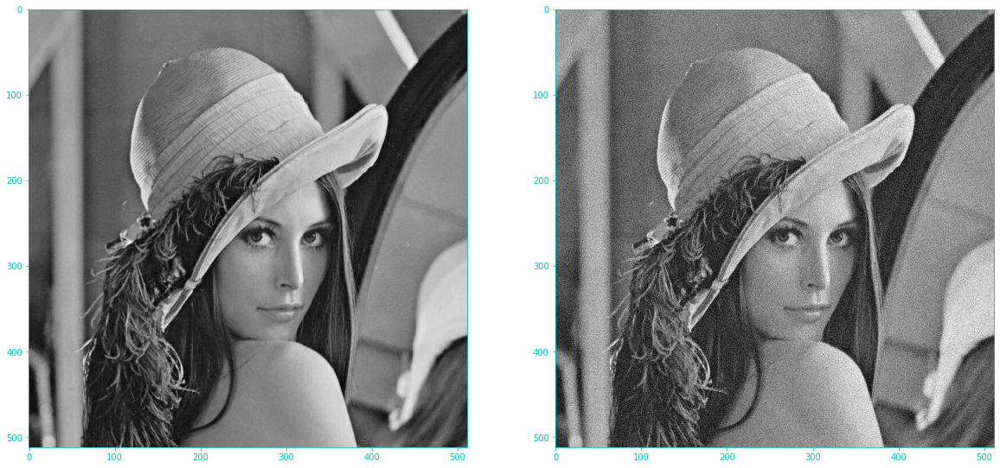

In [23]:
img_gauss_10 = add_noise(add_gaussian,10)

RMSE:  20.021368341776732
SNR:  16.521471022699025
PSNR:  22.100928496487086


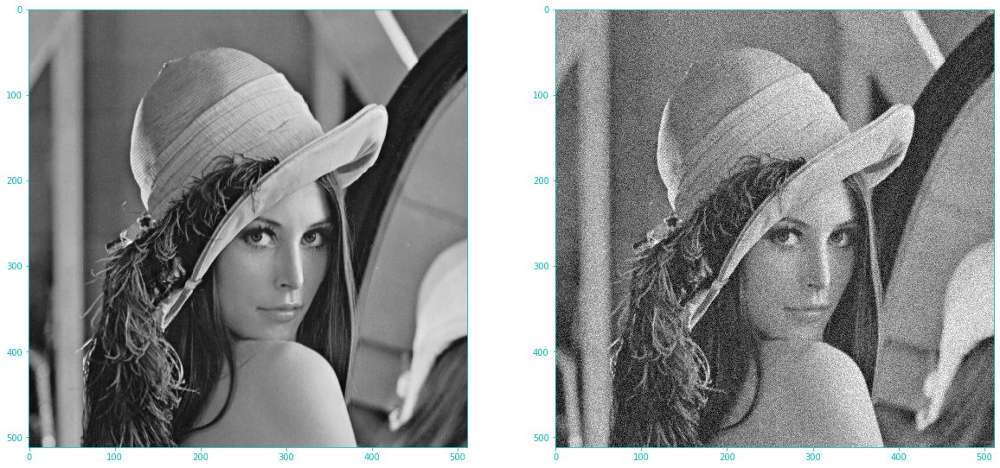

In [24]:
img_gauss_20 = add_noise(add_gaussian, 20)

RMSE:  47.75626096571821
SNR:  9.368508987090557
PSNR:  14.550197273691374


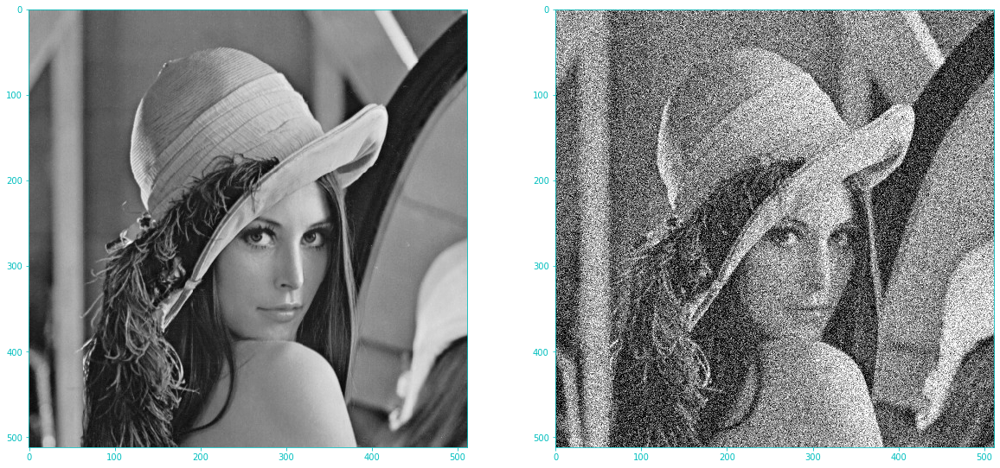

In [25]:
img_gauss_50 = add_noise(add_gaussian, 50)

# Konwolucja

In [7]:
def convolution(img, kernel, k, x, y):
    value = 0
    for i in range(-k, k+1):
        for j in range(-k, k+1):
            value += kernel[i+k, j+k] * img[x+i, y+j]     
    return value 
def get_area(img, size, x, y):
    offset =(size- 1) // 2
    start_row = x - offset
    start_column = y - offset
    area = deepcopy(img[start_row:start_row+size, start_column:start_column+size])
    return area

# Filtry lokalne liniowe

## średnia

In [8]:
def filter_avg(img, area, center):
    x,y = img.shape

    img2 = deepcopy(img)
    kernel = np.ones((area, area), np.float32)
    kernel[area//2, area//2] = center
    kernel_sum = np.sum(kernel)
    offset =(area- 1) // 2

    for i in range(offset, x - offset):
        for j in range(offset, y - offset):
            img2[i,j] = convolution(img, kernel, offset, i,j) // kernel_sum
    return img2

## gauss

In [9]:
def filter_gauss(img, area, sigma):
    kernel = np.zeros((area, area), np.float32)
    k = area //2
    for i in range(-k, k+1):
        for j in range(-k, k+1):
            kernel[i+k, j+k] = (1/2*np.pi*sigma**2)*np.exp(-(i**2+j**2)/(2*sigma**2))
    kernel_sum = np.sum(kernel)
    
        
    x,y = img.shape
    img2 = deepcopy(img)
    offset =(area- 1) // 2
    for i in range(offset, x - offset):
        for j in range(offset, y - offset):        
            img2[i,j] = convolution(img, kernel, k, i,j)//kernel_sum
    return img2

# Filtry lokalne nieliniowe

## mediana

In [10]:
 def filter_median(img, area,val):
    x,y = img.shape
    img2 = deepcopy(img)
    offset =(area- 1) // 2
    for i in range(offset, x - offset):
        for j in range(offset, y - offset):
            img2[i,j] = int(np.median(get_area(img, area, i, j)))
    return img2

## konserwatywne wygładzanie

In [11]:
def filter_conservative_smoothing(img, area,val):
    x,y = img.shape
    img2 = deepcopy(img)
    offset =(area- 1) // 2
    for i in range(offset, x - offset):
        for j in range(offset, y - offset):
            neigh = get_area(img, area, i, j)
            neigh[area//2, area//2] = neigh[0,0]
            img_max = int(np.max(neigh))
            img_min = int(np.min(neigh))
            if img2[i,j] < img_min: 
                img2[i,j] = img_min
            if img2[i,j] > img_max:
                img2[i,j] = img_max
    return img2

# Filtry nielokalne

## średnia

In [12]:
def filter_nl_avg(img, area, val):
    img2 = deepcopy(img)
    img2 = img2.astype('float64')
    x,y = img.shape

    kernel = np.ones((area, area), np.float64)
    kernel_sum = np.sum(kernel)
    offset = (area- 1) // 2

    for i in range(offset, x - offset):
        for j in range(offset, y - offset):
            img2[i,j] = convolution(img, kernel, offset, i,j) / kernel_sum
    
    img3 = deepcopy(img)
    
    for i in range(0, x):
        for j in range(0, y):
            sum = 0
            scalar = 0
            for p in range(0, x):
                for q in range(0, y):
                    w_val = math.exp(-(img2[i,j]-img2[p,q])**2)
                    scalar += w_val
                    sum += img[p,q]*w_val
            img3[i,j] = sum / scalar
    
    return img3

# Testy

In [13]:
def add_filter(img_filt, fun, area, val):
    img2 = fun(img_filt, area, val)
    fix, ax = plt.subplots(1,2)
    fix.set_size_inches(20,10)
    ax[0].imshow(img_filt, cmap='gray') 
    ax[1].imshow(img2, cmap='gray') 

    plt.show()
    print("RMSE przed filtrem: ", rmse(img,img_filt), " RMSE po filtrze: ", rmse(img,img2))
    print("SNR przed filtrem: ",decybel(snr(img, img_filt)), " SNR po filtrze: ", decybel(snr(img,img2)))
    print("PSNR przed filtrem: ",decybel(psnr(img, img_filt)), " PSNR po filtrze: ", decybel(psnr(img,img2)))

## średnia z centrum 1

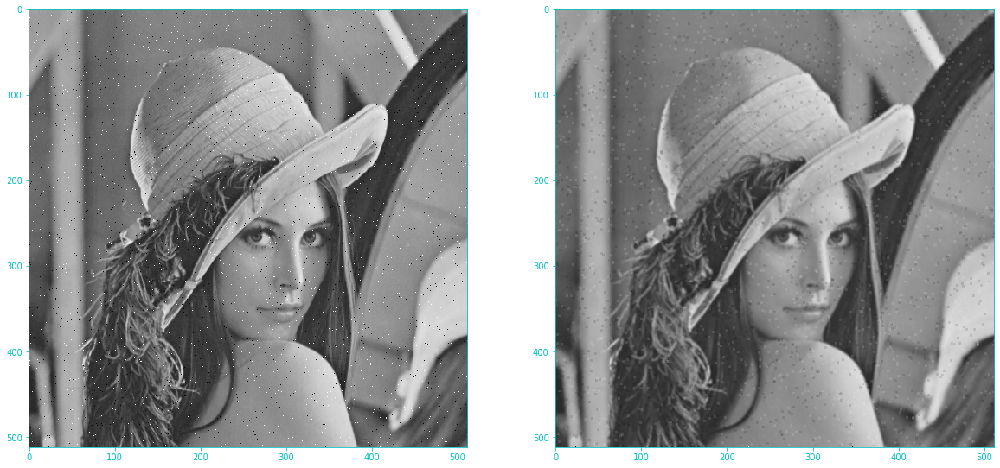

RMSE przed filtrem:  13.57477699504076  RMSE po filtrze:  6.646894730940831
SNR przed filtrem:  19.863128701677336  SNR po filtrze:  25.980686248140756
PSNR przed filtrem:  25.476149533139125  PSNR po filtrze:  31.67842759339949


In [34]:
add_filter(img_salt_pepper_1, filter_avg, 3, 1)

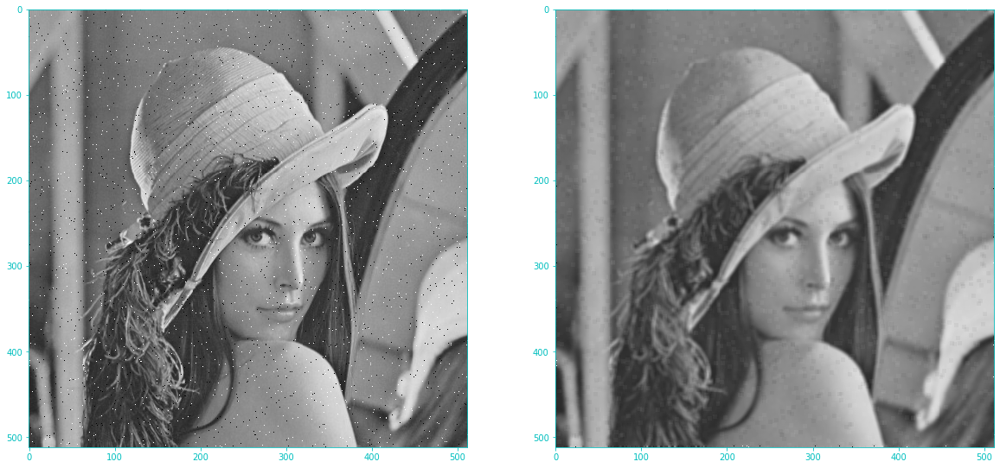

RMSE przed filtrem:  13.57477699504076  RMSE po filtrze:  8.358442422060488
SNR przed filtrem:  19.863128701677336  SNR po filtrze:  23.96859035975637
PSNR przed filtrem:  25.476149533139125  PSNR po filtrze:  29.688296506137114


In [35]:
add_filter(img_salt_pepper_1, filter_avg, 5, 1)

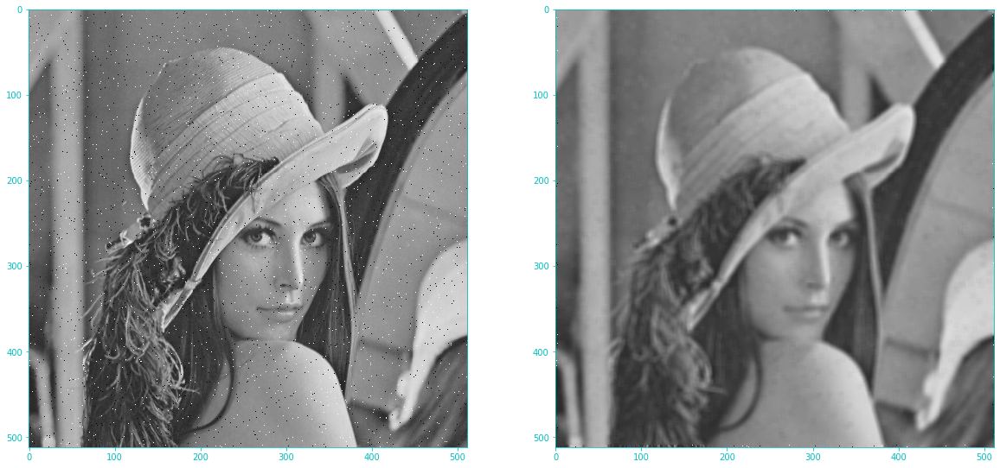

RMSE przed filtrem:  13.57477699504076  RMSE po filtrze:  10.274290007404405
SNR przed filtrem:  19.863128701677336  SNR po filtrze:  22.159862988156426
PSNR przed filtrem:  25.476149533139125  PSNR po filtrze:  27.895767205055456


In [36]:
add_filter(img_salt_pepper_1, filter_avg, 7, 1)

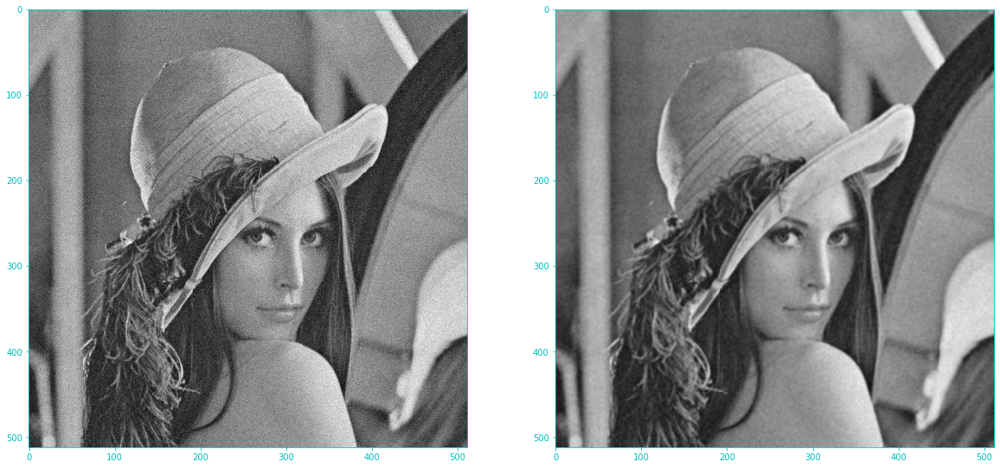

RMSE przed filtrem:  10.006773180749466  RMSE po filtrze:  5.838012489841296
SNR przed filtrem:  22.471226810366446  SNR po filtrze:  27.084362472879214
PSNR przed filtrem:  28.12492249009945  PSNR po filtrze:  32.458021291642474


In [37]:
add_filter(img_gauss_10, filter_avg, 3, 1)

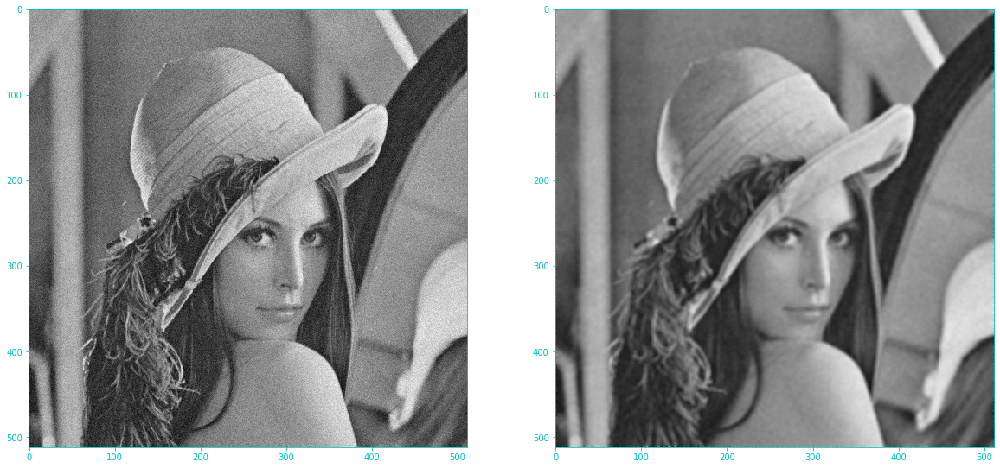

RMSE przed filtrem:  10.006773180749466  RMSE po filtrze:  8.015723036376595
SNR przed filtrem:  22.471226810366446  SNR po filtrze:  24.30972845899158
PSNR przed filtrem:  28.12492249009945  PSNR po filtrze:  29.704467631226844


In [38]:
add_filter(img_gauss_10, filter_avg, 5, 1)

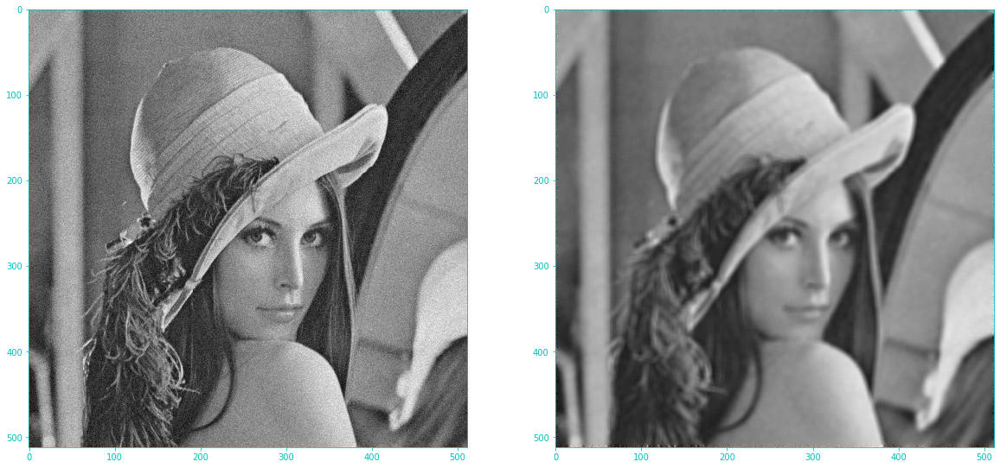

RMSE przed filtrem:  10.006773180749466  RMSE po filtrze:  10.007014675336613
SNR przed filtrem:  22.471226810366446  SNR po filtrze:  22.365846261899076
PSNR przed filtrem:  28.12492249009945  PSNR po filtrze:  27.77723095368486


In [39]:
add_filter(img_gauss_10, filter_avg, 7, 1)

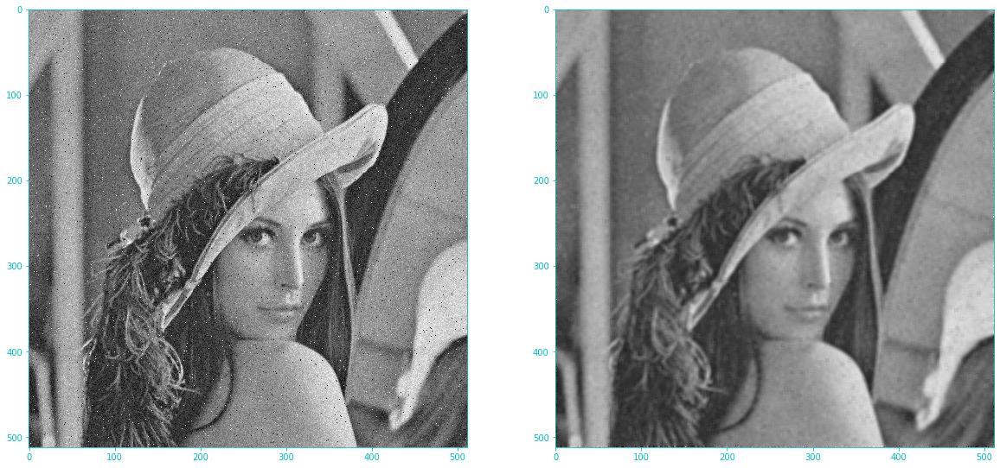

RMSE przed filtrem:  19.994805138170957  RMSE po filtrze:  9.023305599685322
SNR przed filtrem:  16.52302583335797  SNR po filtrze:  23.277300179867343
PSNR przed filtrem:  22.112460088280002  PSNR po filtrze:  29.023490284201866


In [40]:
add_filter(img_salt_papper_gauss, filter_avg, 5, 1)

## Gauss

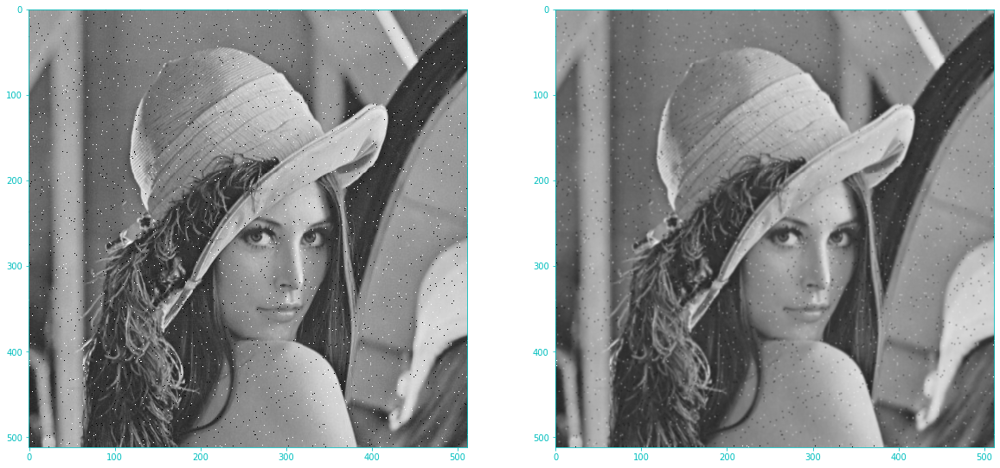

RMSE przed filtrem:  13.57477699504076  RMSE po filtrze:  6.522008755403998
SNR przed filtrem:  19.863128701677336  SNR po filtrze:  26.144453499393187
PSNR przed filtrem:  25.476149533139125  PSNR po filtrze:  31.84317605898874


In [41]:
add_filter(img_salt_pepper_1, filter_gauss, 5, 0.8)

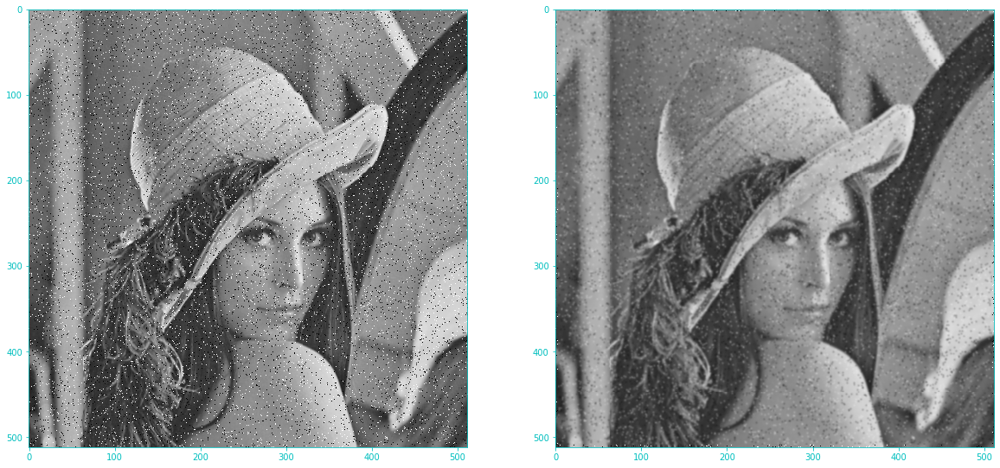

RMSE przed filtrem:  30.311892033408597  RMSE po filtrze:  11.127218646724424
SNR przed filtrem:  13.026042082061391  SNR po filtrze:  21.4812693818744
PSNR przed filtrem:  18.4985427011725  PSNR po filtrze:  27.203071170742398


In [42]:
add_filter(img_salt_pepper_5, filter_gauss, 7, 1)

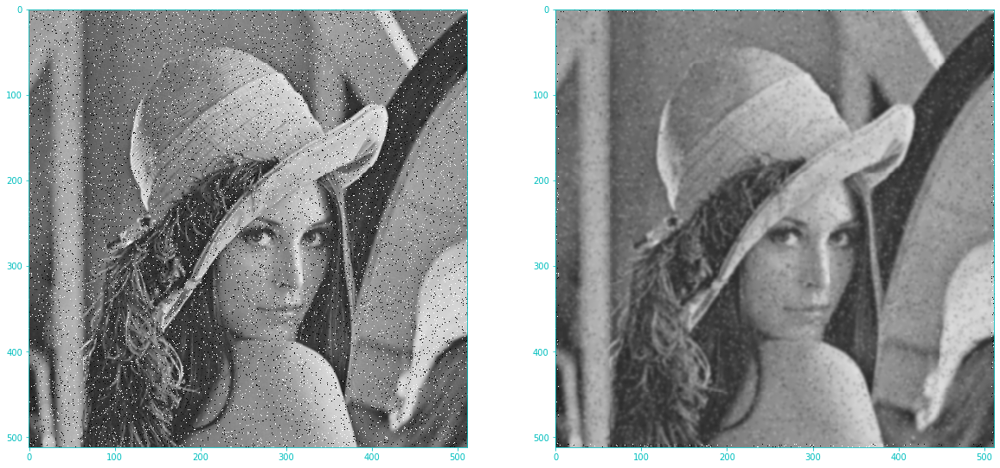

RMSE przed filtrem:  30.311892033408597  RMSE po filtrze:  10.84911501742778
SNR przed filtrem:  13.026042082061391  SNR po filtrze:  21.680611593640894
PSNR przed filtrem:  18.4985427011725  PSNR po filtrze:  27.42291734033018


In [43]:
add_filter(img_salt_pepper_5, filter_gauss, 9, 1.5)

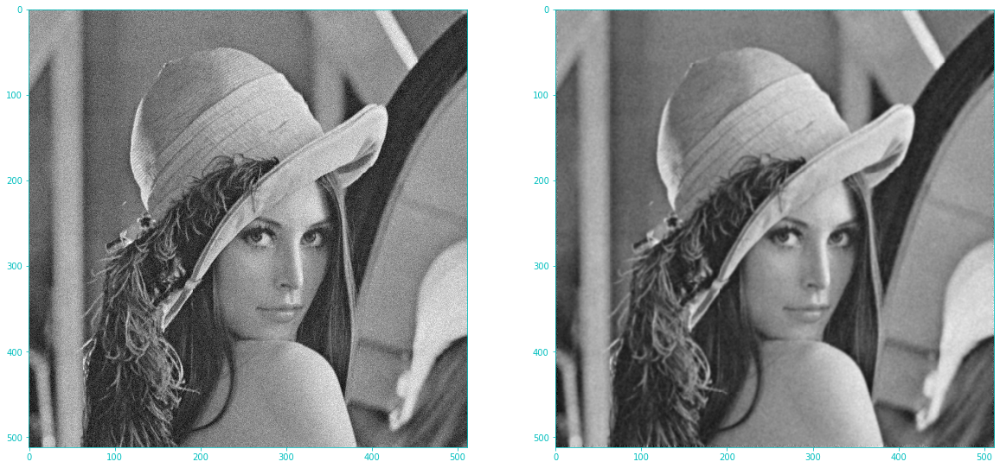

RMSE przed filtrem:  10.006773180749466  RMSE po filtrze:  5.986214058864327
SNR przed filtrem:  22.471226810366446  SNR po filtrze:  26.85856189216638
PSNR przed filtrem:  28.12492249009945  PSNR po filtrze:  32.24027683606648


In [44]:
add_filter(img_gauss_10, filter_gauss, 7, 1)

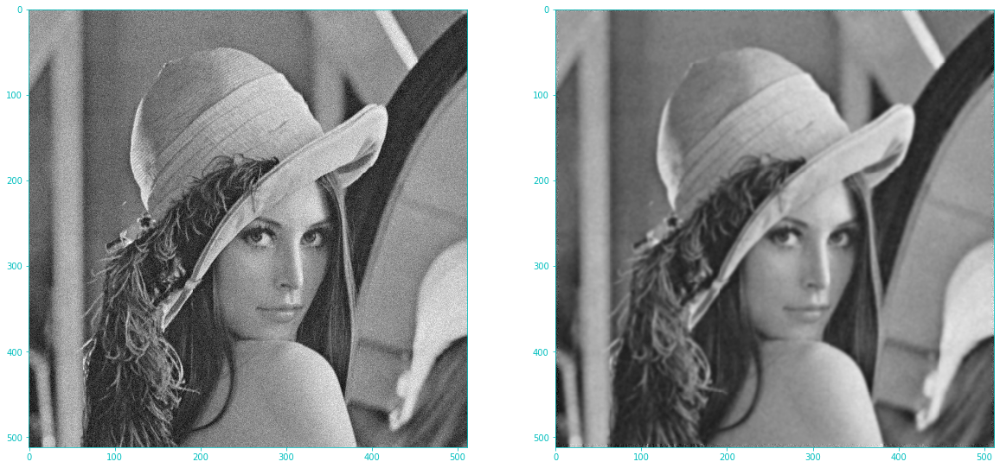

RMSE przed filtrem:  10.006773180749466  RMSE po filtrze:  7.612711525469721
SNR przed filtrem:  22.471226810366446  SNR po filtrze:  24.756531124817805
PSNR przed filtrem:  28.12492249009945  PSNR po filtrze:  30.152534226510088


In [45]:
add_filter(img_gauss_10, filter_gauss, 9, 1.5)

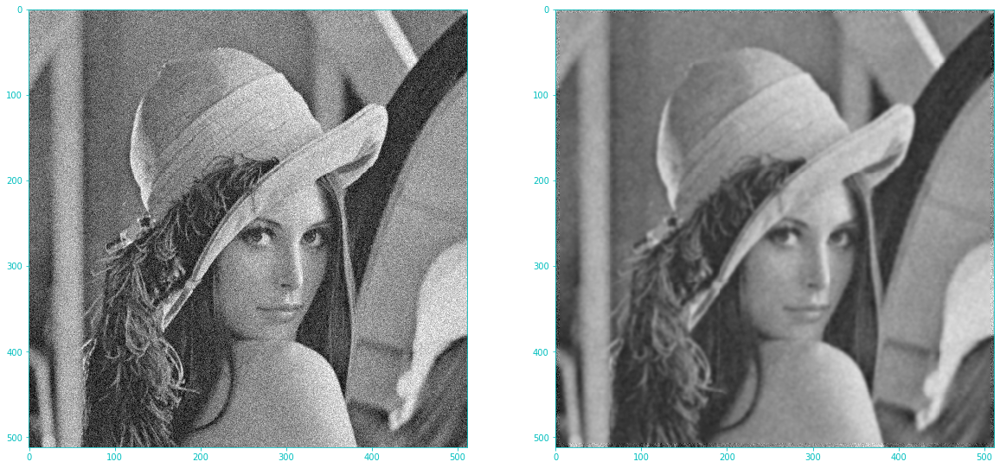

RMSE przed filtrem:  19.9790562642229  RMSE po filtrze:  9.396147413283712
SNR przed filtrem:  16.535480608743974  SNR po filtrze:  22.925199678700537
PSNR przed filtrem:  22.119304210079353  PSNR po filtrze:  28.67180717523212


In [46]:
add_filter(img_gauss_20, filter_gauss, 11, 1.7)

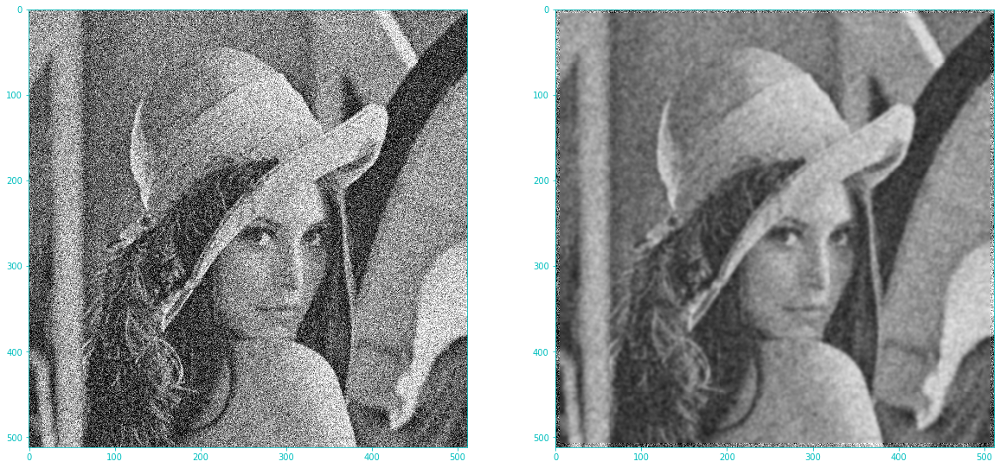

RMSE przed filtrem:  47.61056700348218  RMSE po filtrze:  14.834585729869758
SNR przed filtrem:  9.391681337238241  SNR po filtrze:  18.959747643660467
PSNR przed filtrem:  14.576736536627568  PSNR po filtrze:  24.705295154089985


In [47]:
add_filter(img_gauss_50, filter_gauss, 11, 1.7)

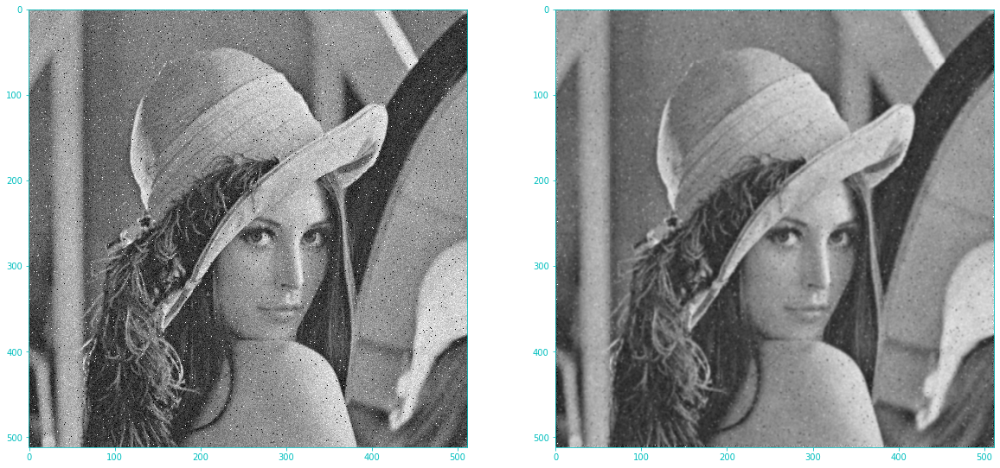

RMSE przed filtrem:  19.994805138170957  RMSE po filtrze:  8.163459952719693
SNR przed filtrem:  16.52302583335797  SNR po filtrze:  24.163202091023827
PSNR przed filtrem:  22.112460088280002  PSNR po filtrze:  29.893318276998645


In [48]:
add_filter(img_salt_papper_gauss, filter_gauss, 7, 1)

## mediana

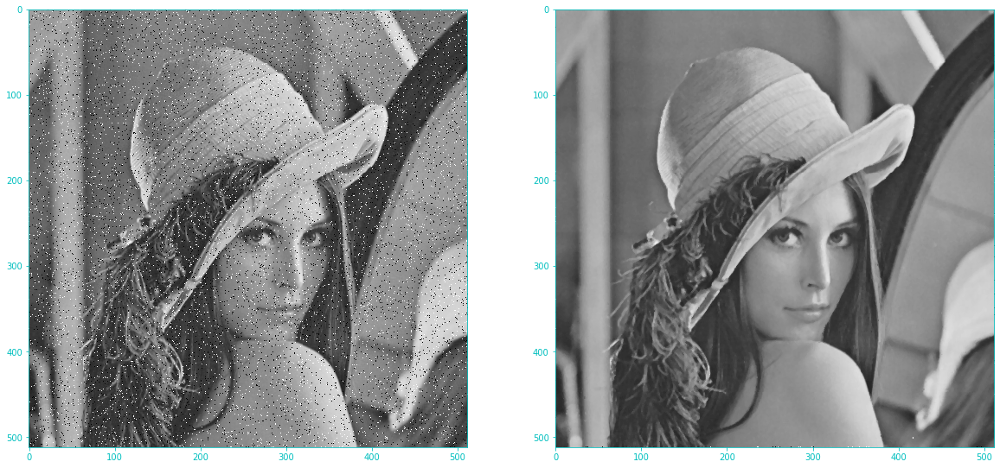

RMSE przed filtrem:  30.311892033408597  RMSE po filtrze:  4.701144286115557
SNR przed filtrem:  13.026042082061391  SNR po filtrze:  29.02702057897414
PSNR przed filtrem:  18.4985427011725  PSNR po filtrze:  34.68673199609388


In [49]:
add_filter(img_salt_pepper_5, filter_median, 3, 1)

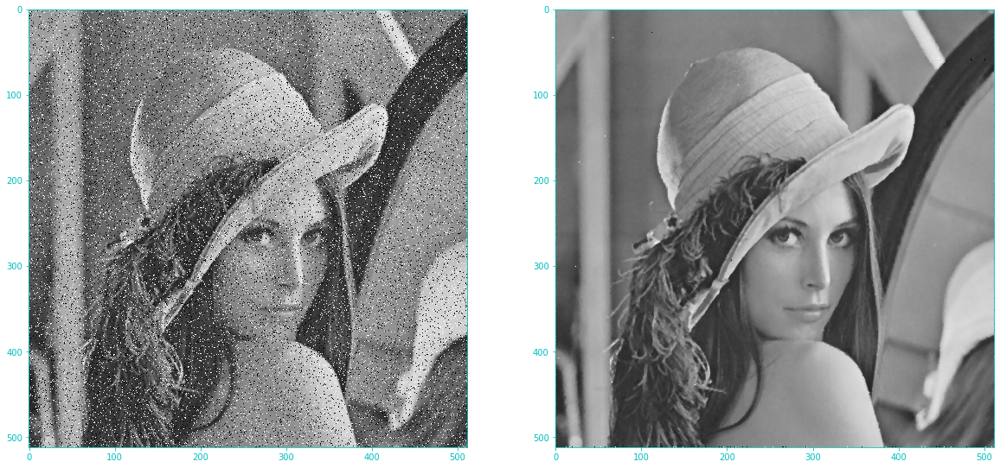

RMSE przed filtrem:  42.4792254667201  RMSE po filtrze:  5.880476326884982
SNR przed filtrem:  10.266547429664332  SNR po filtrze:  27.08613788876681
PSNR przed filtrem:  15.567271817547997  PSNR po filtrze:  32.742553489335656


In [50]:
add_filter(img_salt_pepper_10, filter_median, 3, 1)

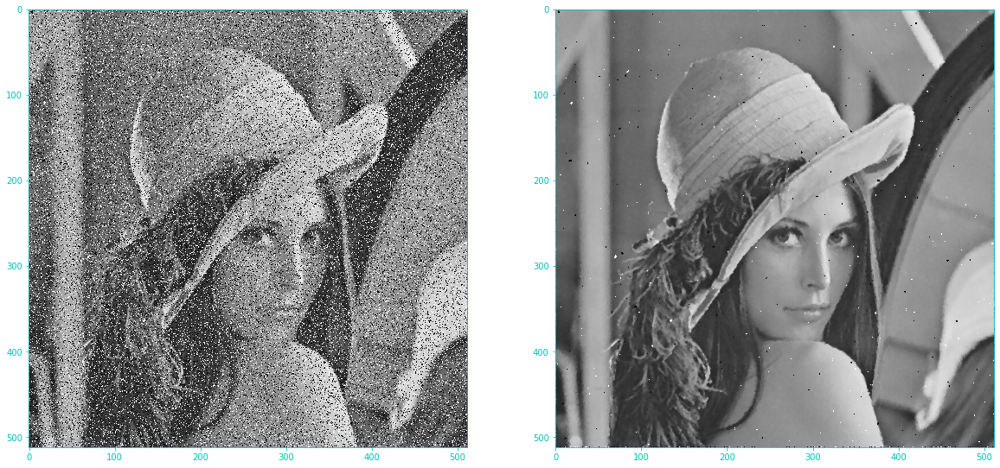

RMSE przed filtrem:  60.33477296042503  RMSE po filtrze:  9.732394241946022
SNR przed filtrem:  7.535477226214668  SNR po filtrze:  22.718296340008656
PSNR przed filtrem:  12.519449952215924  PSNR po filtrze:  28.366409746467326


In [51]:
add_filter(img_salt_pepper_20, filter_median, 3, 1)

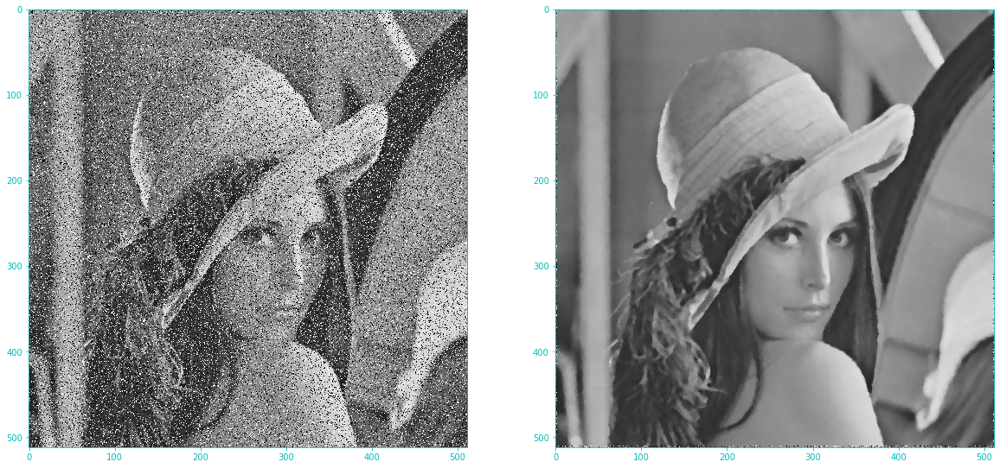

RMSE przed filtrem:  60.33477296042503  RMSE po filtrze:  10.260125532070155
SNR przed filtrem:  7.535477226214668  SNR po filtrze:  22.24400455452635
PSNR przed filtrem:  12.519449952215924  PSNR po filtrze:  27.907750121132242


In [52]:
add_filter(img_salt_pepper_20, filter_median, 5, 1)

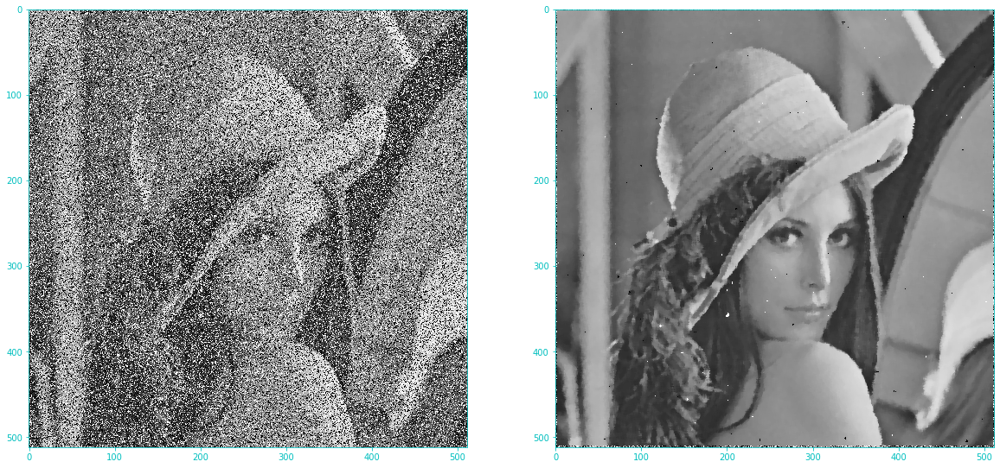

RMSE przed filtrem:  85.52860321420803  RMSE po filtrze:  14.115249509210788
SNR przed filtrem:  5.090860130344503  SNR po filtrze:  19.49279009099476
PSNR przed filtrem:  9.488576018047599  PSNR po filtrze:  25.137032420918032


In [53]:
add_filter(img_salt_pepper_40, filter_median, 5, 1)

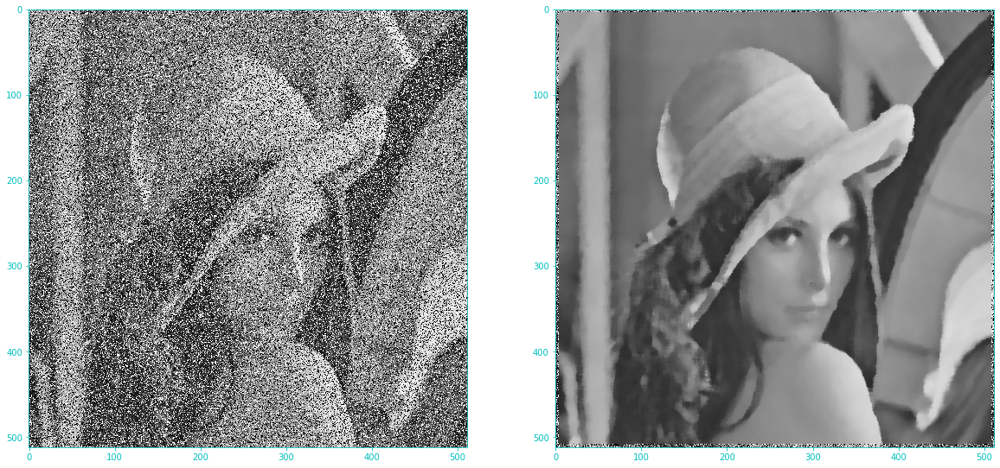

RMSE przed filtrem:  85.52860321420803  RMSE po filtrze:  18.2298130582012
SNR przed filtrem:  5.090860130344503  SNR po filtrze:  17.27294180592935
PSNR przed filtrem:  9.488576018047599  PSNR po filtrze:  22.915159306570175


In [54]:
add_filter(img_salt_pepper_40, filter_median, 9, 1)

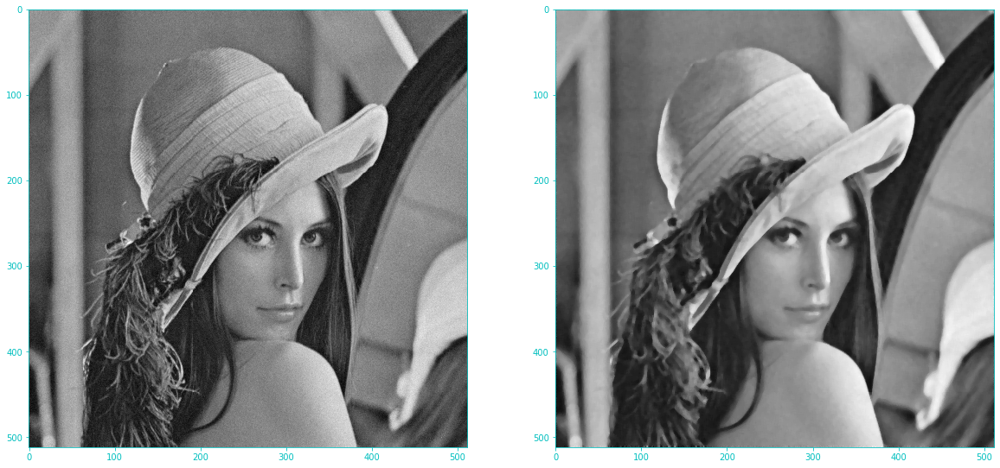

RMSE przed filtrem:  5.034201567756766  RMSE po filtrze:  6.4596159943099805
SNR przed filtrem:  28.419039044257435  SNR po filtrze:  26.21852562278948
PSNR przed filtrem:  34.092191597336715  PSNR po filtrze:  31.068105573882818


In [55]:
add_filter(img_gauss_5, filter_median, 5, 1)

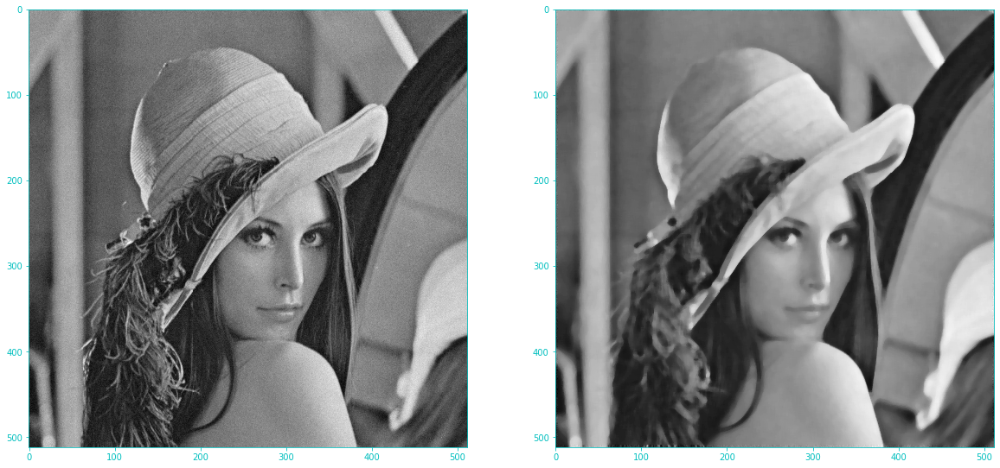

RMSE przed filtrem:  5.034201567756766  RMSE po filtrze:  8.170731473602636
SNR przed filtrem:  28.419039044257435  SNR po filtrze:  24.165122220752593
PSNR przed filtrem:  34.092191597336715  PSNR po filtrze:  29.027020839950634


In [56]:
add_filter(img_gauss_5, filter_median, 7, 1)

## konserwatywne wygładzanie

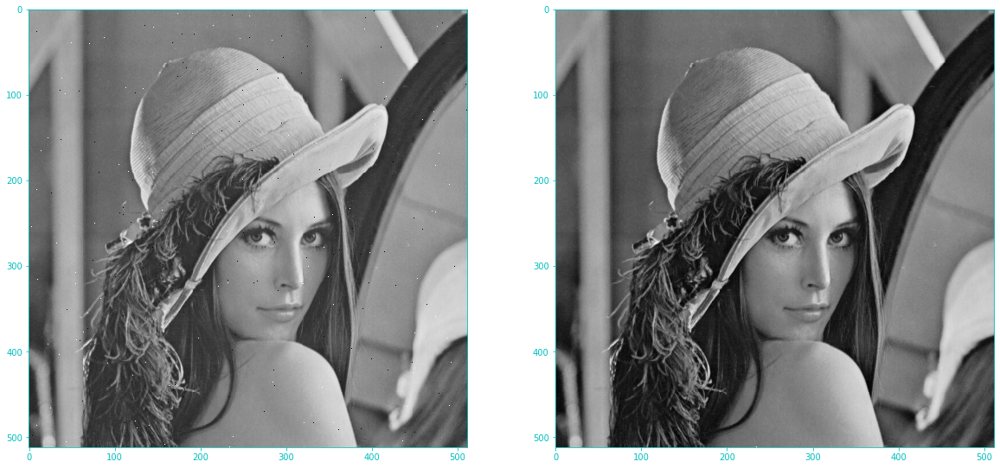

RMSE przed filtrem:  3.7755431940201807  RMSE po filtrze:  0.8192748273172936
SNR przed filtrem:  30.944899506515426  SNR po filtrze:  44.21236328012363
PSNR przed filtrem:  36.591214745297414  PSNR po filtrze:  49.86221138626584


In [57]:
add_filter(img_salt_pepper_01, filter_conservative_smoothing, 3, 1)

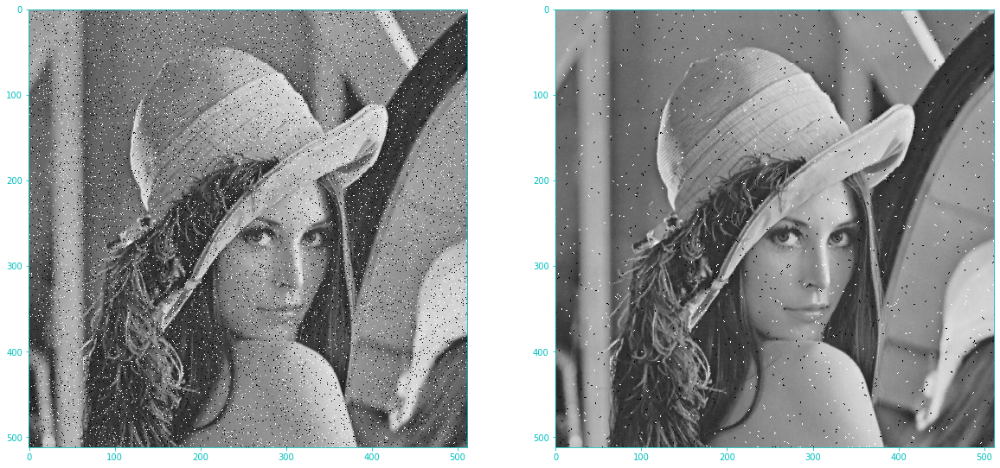

RMSE przed filtrem:  30.311892033408597  RMSE po filtrze:  13.382524316894969
SNR przed filtrem:  13.026042082061391  SNR po filtrze:  19.986315515682268
PSNR przed filtrem:  18.4985427011725  PSNR po filtrze:  25.600042784743327


In [58]:
add_filter(img_salt_pepper_5, filter_conservative_smoothing, 3, 1)

implementacja fft 1d i 2d od zera

In [6]:
def fast(x, inv=0): #impl rekurencyjna, drugi arg odpowiada za odwracanie
    n = x.shape[0]
    nums = np.asarray(x)
    if n == 1: return x
    left = fast(x[::2], inv) #wywolanie reku dla parzystych i niepazystych
    right = fast(x[1::2], inv)
    if inv==0:
        inverted_root = np.exp(2 * np.pi * 1j / n)
    if inv==1:
        inverted_root = np.exp(2 * np.pi * -1j / n)
    root = 1
    res = np.zeros((n),dtype=complex)
    for i in range(0, int(n/2)):
        res[i] = left[i] + root * right[i]
        res[int(i + n/2)] = left[i] - root * right[i]
        root = root * inverted_root
        if inv==1:
            res[i]/=2
            res[int(i+n/2)]/=2
    return res

In [7]:
def fft2d(x, inv=0): #fast fourier transform 2D
    sh = x.shape
    z = np.zeros((sh[0],sh[1]), dtype=complex)
    if inv==0:
        for i in range(sh[0]):
            z[i,:] = fast(x[i,:],0)
        for i in range(sh[1]):
            z[:,i] = fast(z[:,i],0)
    if inv==1:
        for i in range(sh[0]):
            z[i,:] = fast(x[i,:],1)
        for i in range(sh[1]):
            z[:,i] = fast(z[:,i],1)
    return z

In [8]:
def shift(x): #przeksztlacenie S z prezentacji
    n = x.shape[0]; m = x.shape[1]
    y = np.copy(x)
    y[int(n/2):, int(m/2):] = x[:int(n/2), :int(m/2)]
    y[:int(n/2), :int(m/2)] = x[int(n/2):, int(m/2):]
    y[int(n/2):, :int(m/2)] = x[:int(n/2), int(m/2):]
    y[:int(n/2), int(m/2):] = x[int(n/2):, :int(m/2)]
    return y

Lena w częstotliwości

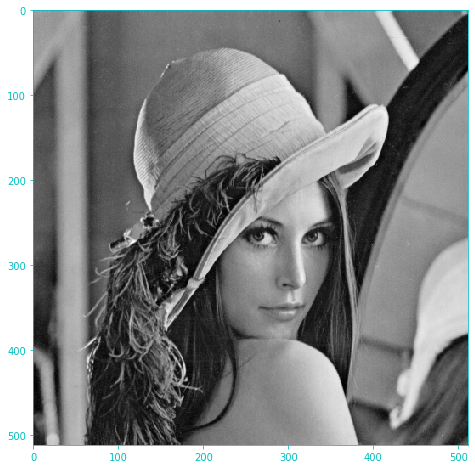

/home/oskar/.local/lib/python3.7/site-packages/ipykernel_launcher.py:10: ComplexWarning: Casting complex values to real discards the imaginary part
  # Remove the CWD from sys.path while we load stuff.


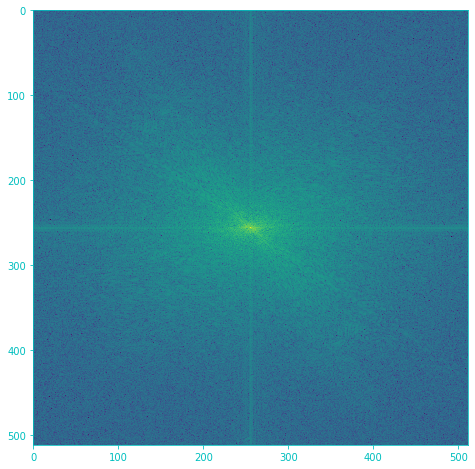

In [12]:
im_lena = Image.open('lena512.bmp').convert('L') # grayscale
lena = np.array(im_lena)

plt.figure(figsize=(8,8))
plt.imshow(lena, cmap='gray')
plt.show()
freq = fft2d(lena)
freq = shift(freq)
plt.figure(figsize=(8,8))
plt.imshow( (20*np.log10( 0.1 + freq)).astype(int))
plt.show()

/home/oskar/.local/lib/python3.7/site-packages/ipykernel_launcher.py:3: ComplexWarning: Casting complex values to real discards the imaginary part
  This is separate from the ipykernel package so we can avoid doing imports until


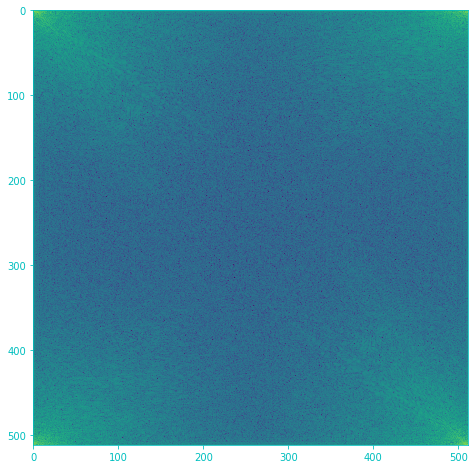

In [13]:
freq = fft2d(lena)
plt.figure(figsize=(8,8))
plt.imshow( (20*np.log10( 0.1 + freq)).astype(int))
plt.show()

filtry w dziedzinie częstotliwości

In [14]:
def ideal_low(x,r):
    r = r*r #r = odleglosc od srodka
    M = x.shape[0]; N = x.shape[1]
    pt = np.sum(np.square(np.absolute(x)))
    p = 0
    for i in range(M):
        dist_i = (i-M/2)*(i-M/2)
        for j in range(N):
            if dist_i + (j-N/2)*(j-N/2) > r:
                x[i,j]=0
            else:
                p += np.square(np.abs(x[i,j]))
    print('zachowany procent mocy = ', p/pt*100)
    return x

def ideal_ell(x,r): #ellptical cutoff
    r = r*r #r = odleglosc od srodka
    M = x.shape[0]; N = x.shape[1]
    coeff = M/N
    for i in range(M):
        dist_i = (i-M/2)*(i-M/2)
        for j in range(N):
            if dist_i + (j-N/2)*(j-N/2)*coeff*coeff > r:
                x[i,j]=0
    return x

def butterworth(x,r,n):
    M = x.shape[0]; N = x.shape[1]
    pt = np.sum(np.square(np.absolute(x)))
    p = 0
    for i in range(M):
        dist_i = (i-M/2)*(i-M/2)
        for j in range(N):
            dist_j = (j-N/2)*(j-N/2)
            par = 1/(1 + ((np.sqrt(dist_i+dist_j))/r)**(2*n))
            x[i,j] *= par
            p += np.square(np.abs(x[i,j]))
    print('zachowany procent mocy = ', p/pt*100)
    return x

def gaussian_low(x,r):
    r = r*r #r = odleglosc od srodka
    M = x.shape[0]; N = x.shape[1]
    pt = np.sum(np.square(np.absolute(x)))
    p = 0
    for i in range(M):
        dist_i = (i-M/2)*(i-M/2)
        for j in range(N):
            dist_j = (j-N/2)*(j-N/2)
            par = np.exp(-(dist_i + dist_j)/(2*r))
            x[i,j]*= par
            p += np.square(np.abs(x[i,j]))
    print('zachowany procent mocy = ', p/pt*100)
    return x

In [15]:
def filtering_choice(image, method, r=0, n=0):
    freq = fft2d(image,0)
    freq = shift(freq)
    
    if method=='low': freq = ideal_low(freq,r)
    elif method=='butter': freq = butterworth(freq,r,n)
    elif method=='gauss': freq = gaussian_low(freq,r)
    else: 
        print("invalid method name")
        return
    freq = shift(freq)
    rev = fft2d(freq,1).real
    plt.figure(figsize=(15,10))
    plt.imshow(rev, cmap='gray')
    plt.show()
    return rev

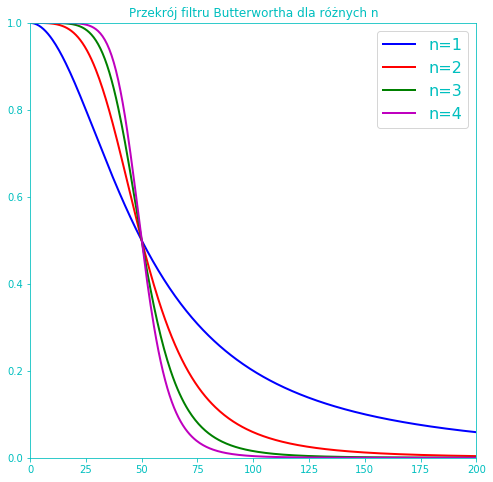

In [12]:
def f1(t):
    return 1/(1+(t/50)**2)
def f2(t):
    return 1/(1+(t/50)**4)
def f3(t):
    return 1/(1+(t/50)**6)
def f4(t):
    return 1/(1+(t/50)**8)
t1 = np.arange(0,200,0.5)

plt.figure(figsize=(8,8))
plt.xlim(0,200)
plt.ylim(0,1)
plt.plot(t1, f1(t1), 'b-', label='n=1', linewidth=2) 
plt.plot(t1, f2(t1), 'r-', label='n=2', linewidth=2) 
plt.plot(t1, f3(t1), 'g-', label='n=3', linewidth=2) 
plt.plot(t1, f4(t1), 'm-', label='n=4', linewidth=2)
plt.title('Przekrój filtru Butterwortha dla różnych n')
plt.legend(prop={'size': 16})
plt.savefig('butter.pdf')

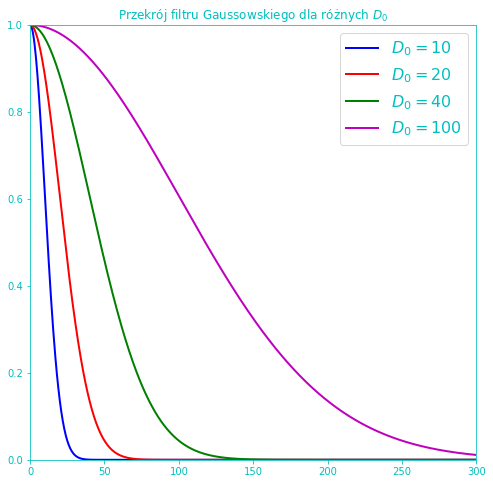

In [13]:
def f1(x):
    return np.exp(-x*x/(2*10*10))
def f2(x):
    return np.exp(-x*x/(2*20*20))
def f3(x):
    return np.exp(-x*x/(2*40*40))
def f4(x):
    return np.exp(-x*x/(2*100*100))
t1 = np.arange(0,300,0.5)

plt.figure(figsize=(8,8))
plt.xlim(0,300)
plt.ylim(0,1)
plt.plot(t1, f1(t1), 'b-', label=r'$D_{0}=10$', linewidth=2) 
plt.plot(t1, f2(t1), 'r-', label=r'$D_{0}=20$', linewidth=2) 
plt.plot(t1, f3(t1), 'g-', label=r'$D_{0}=40$', linewidth=2) 
plt.plot(t1, f4(t1), 'm-', label=r'$D_{0}=100$', linewidth=2)
plt.title(r'Przekrój filtru Gaussowskiego dla różnych $D_{0}$')
plt.legend(prop={'size': 16})

#plt.show()
plt.savefig('gauss.pdf')

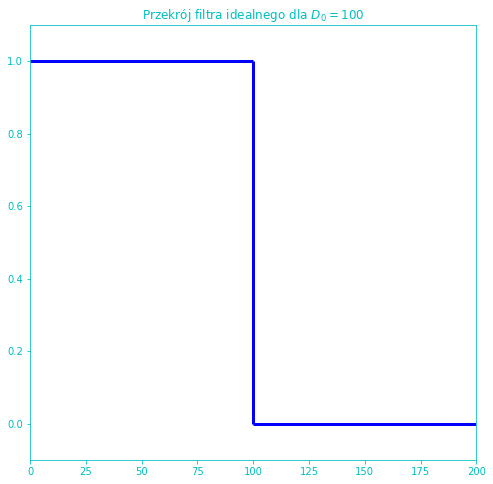

In [14]:

plt.figure(figsize=(8,8))
plt.xlim(0,200)
plt.ylim(-0.1,1.1)
plt.hlines(1,0,100, colors='b', linewidth=3) 
plt.hlines(0,100,200, colors='b',linewidth=3)
plt.vlines(100,0,1, colors='b',linewidth=3)
plt.title(r'Przekrój filtra idealnego dla $D_{0}=100$')

plt.savefig('ideal.pdf')

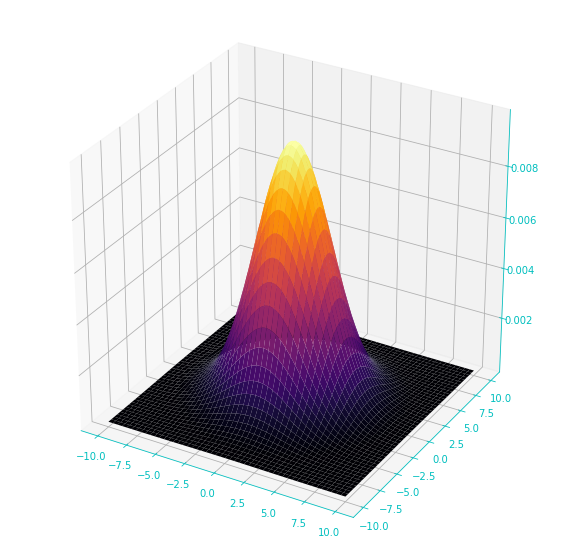

In [300]:
from scipy.stats import multivariate_normal
from mpl_toolkits.mplot3d import Axes3D
mu_x = 0
variance_x = 8

mu_y = 0
variance_y = 8

x = np.linspace(-10,10,500)
y = np.linspace(-10,10,500)
X, Y = np.meshgrid(x,y)
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X; pos[:, :, 1] = Y
rv = multivariate_normal([mu_x, mu_y], [[variance_x, 0], [0, variance_y]])

fig = plt.figure(figsize=(10,10))
ax = fig.gca(projection='3d')
ax.plot_surface(X, Y, rv.pdf(pos)/2,cmap='inferno',linewidth=0)
plt.savefig('gauss2d.pdf')
plt.show()

In [16]:
moon = (Image.open('moonlanding.png'))
moon = moon.crop((50,200,562,456))
moon = np.array(moon)
moon.shape

(256, 512)

zachowany procent mocy =  94.74824560657808


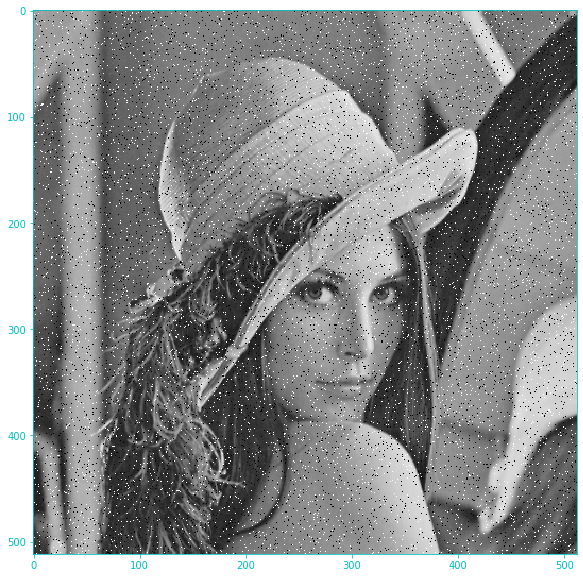

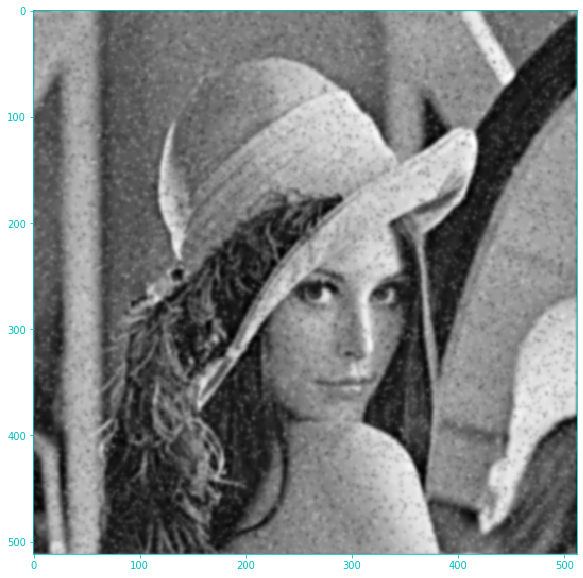

array([[126.56651537, 127.91566014, 132.40775639, ..., 141.5379395 ,
        135.65612659, 129.36564257],
       [146.71446965, 150.38848757, 153.95556751, ..., 155.70384357,
        149.49746558, 145.46884382],
       [156.10227528, 161.40136738, 164.417944  , ..., 158.5363999 ,
        152.95935674, 151.62186956],
       ...,
       [ 64.84155542,  56.56174371,  54.77505847, ...,  97.11977692,
         89.90140762,  78.22967092],
       [ 77.07328389,  71.18844633,  72.61982779, ..., 104.76495593,
         99.51087244,  89.08947988],
       [ 99.23714753,  96.97423302, 101.57142848, ..., 120.91687216,
        115.91483396, 107.4507429 ]])

In [24]:
lena_salt = add_salt_paper(lena,5)
plt.figure(figsize=(15,10))
plt.imshow(lena_salt, cmap='gray')
filtering_choice(lena_salt, 'butter', 70, 2)


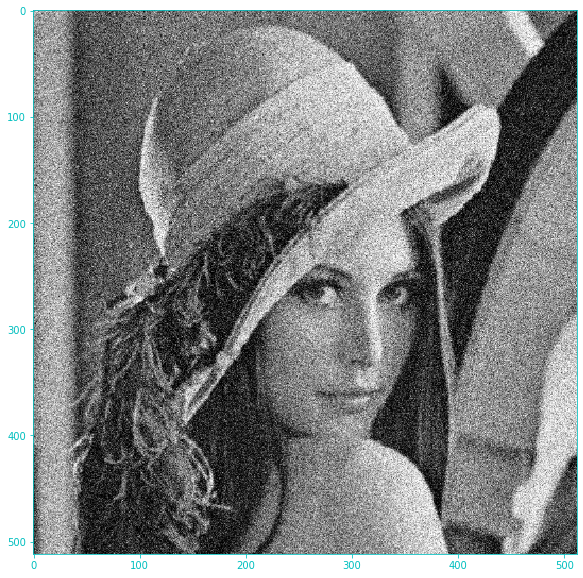

In [27]:
l50 = (Image.open('l50.png')).convert('L')
l50 = l50.crop((30,30,542,542))
l50 = np.asarray(l50)
plt.figure(figsize=(15,10))
plt.imshow(l50, cmap='gray')


zachowany procent mocy =  93.36192265763924


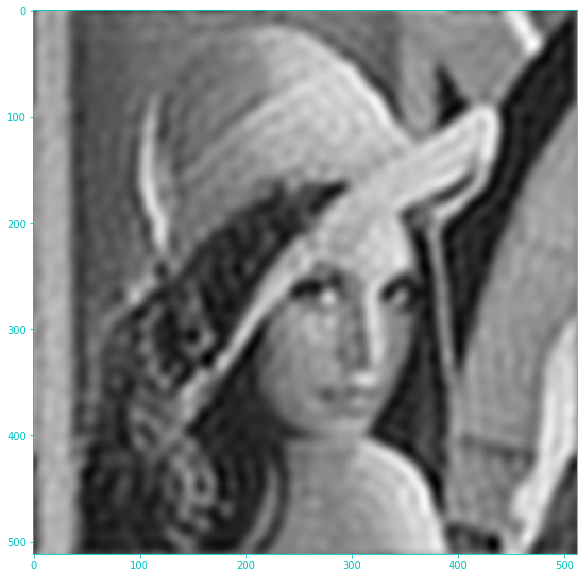

zachowany procent mocy =  93.78700584233631


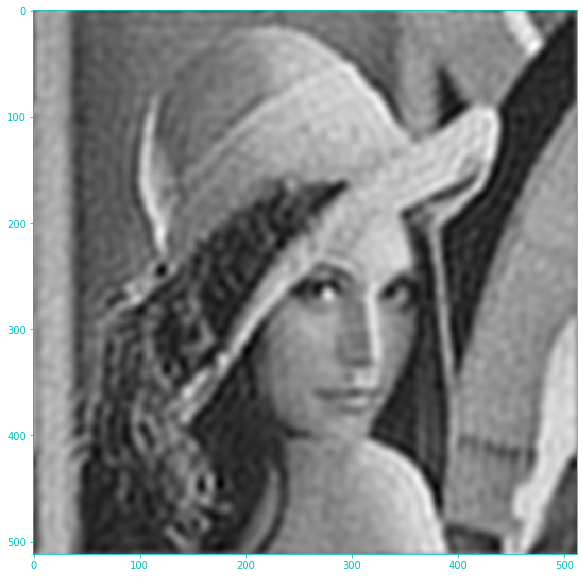

zachowany procent mocy =  94.08104589725265


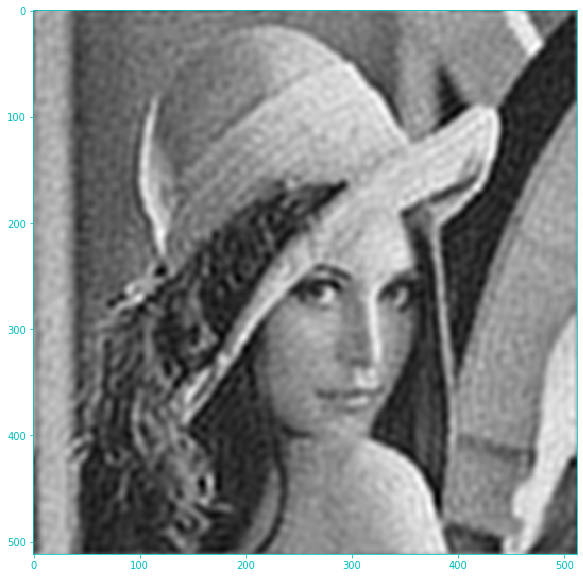

array([[ 97.85431454, 110.45929202, 122.89073371, ...,  70.20960558,
         76.63923004,  86.18926504],
       [106.89635026, 121.49613658, 135.24567011, ...,  73.02818716,
         81.17947744,  92.92873813],
       [113.19176215, 129.78111935, 144.78881391, ...,  72.76666602,
         82.79519016,  96.86184904],
       ...,
       [ 67.69758123,  74.8161115 ,  83.2406938 , ...,  55.76284722,
         58.0051744 ,  62.03543889],
       [ 76.69079919,  85.51246402,  95.25234434, ...,  60.06025497,
         63.54472634,  69.2165668 ],
       [ 87.26474692,  97.92867701, 109.01473478, ...,  65.38688469,
         70.26279158,  77.77871963]])

In [160]:
filtering_choice(l50, 'low', 30)
filtering_choice(l50, 'low', 40)
filtering_choice(l50, 'low', 50)

zachowany procent mocy =  93.12602115106236


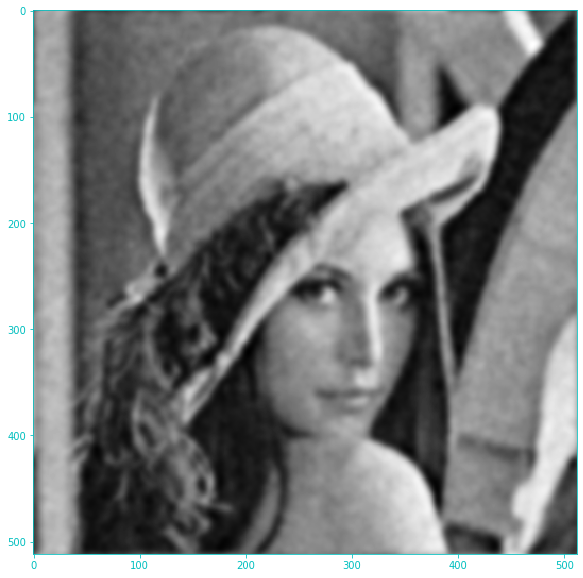

zachowany procent mocy =  93.54261021906203


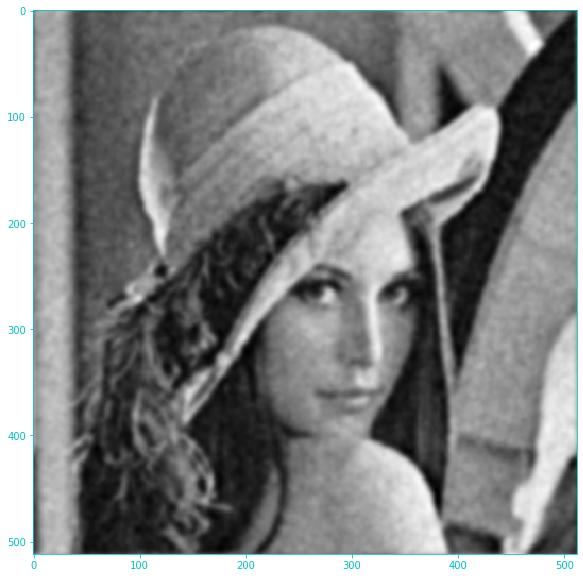

zachowany procent mocy =  93.96478182001236


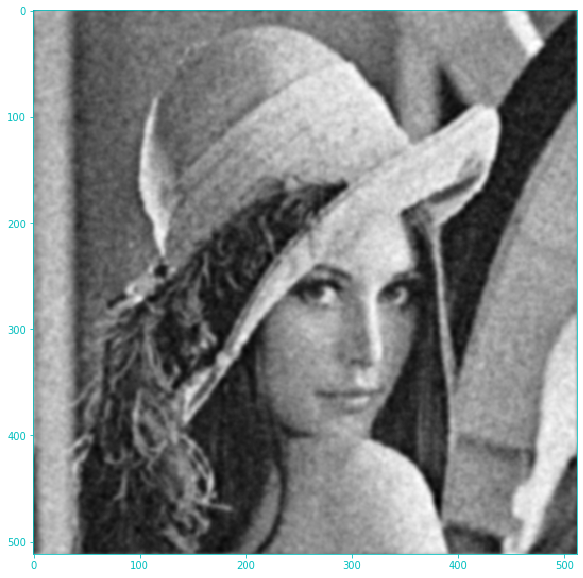

array([[104.6194899 , 122.58891055, 134.87648317, ...,  66.50944225,
         71.69448987,  84.72272142],
       [118.1954454 , 140.34364008, 154.69770892, ...,  67.96792892,
         74.777408  ,  92.27729418],
       [123.80622597, 149.16908453, 164.10793672, ...,  63.45483818,
         71.79200488,  93.34010971],
       ...,
       [ 61.74498023,  70.23834719,  79.67745912, ...,  54.27560434,
         53.84156456,  55.67824473],
       [ 71.2019889 ,  81.01202516,  91.07611102, ...,  56.36733426,
         58.43205891,  63.26740524],
       [ 86.732695  ,  99.85423224, 110.65283196, ...,  60.93666533,
         64.97079295,  73.82797281]])

In [161]:
filtering_choice(l50, 'butter', 35, 2)
filtering_choice(l50, 'butter', 45, 2)
filtering_choice(l50, 'butter', 60, 2)

zachowany procent mocy =  93.10985146172287


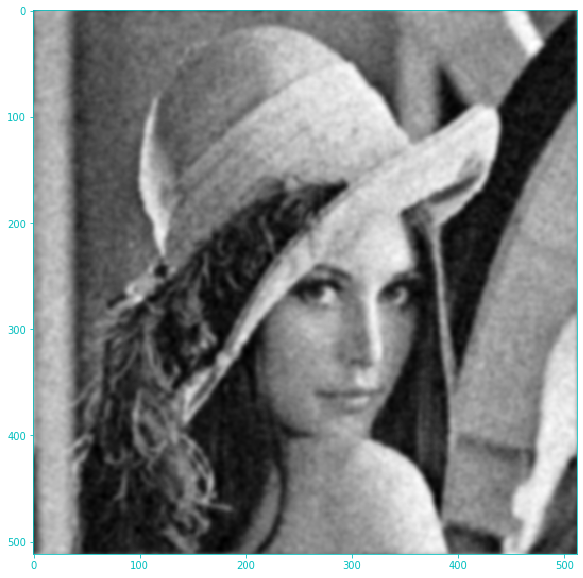

zachowany procent mocy =  93.50436018410328


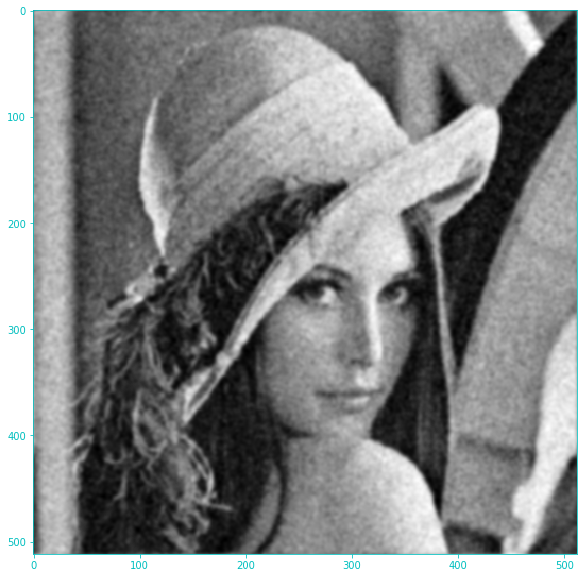

zachowany procent mocy =  93.80853284624224


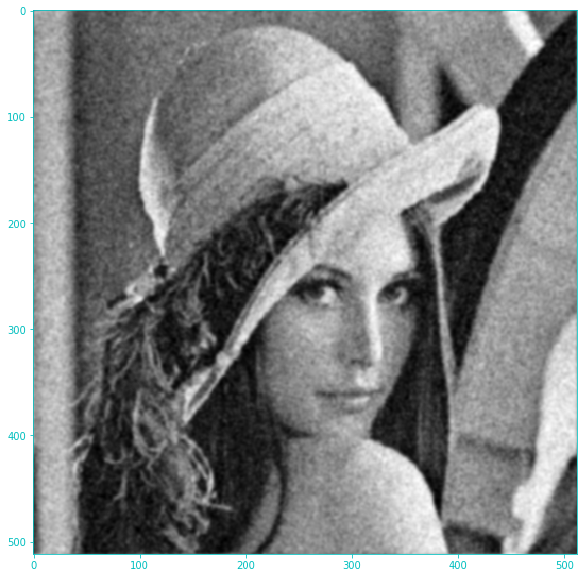

array([[107.26979895, 126.69520453, 137.68902539, ...,  68.03233075,
         71.25570748,  85.01851915],
       [122.70378824, 148.76411338, 161.59164394, ...,  68.47215288,
         72.06711549,  91.53074896],
       [127.54893389, 157.44015256, 170.32821015, ...,  61.54707528,
         66.3645831 ,  90.47739561],
       ...,
       [ 60.59438322,  69.64128465,  79.411164  , ...,  58.43509483,
         56.10324935,  55.6288357 ],
       [ 68.9949879 ,  78.19815979,  87.68971345, ...,  58.82296241,
         59.50620523,  62.27811495],
       [ 86.14760353,  98.83749319, 108.29663833, ...,  62.33694444,
         65.17331271,  73.19303409]])

In [162]:
filtering_choice(l50, 'gauss', 40)
filtering_choice(l50, 'gauss', 50)
filtering_choice(l50, 'gauss', 60)


zdjęcie księżycowe

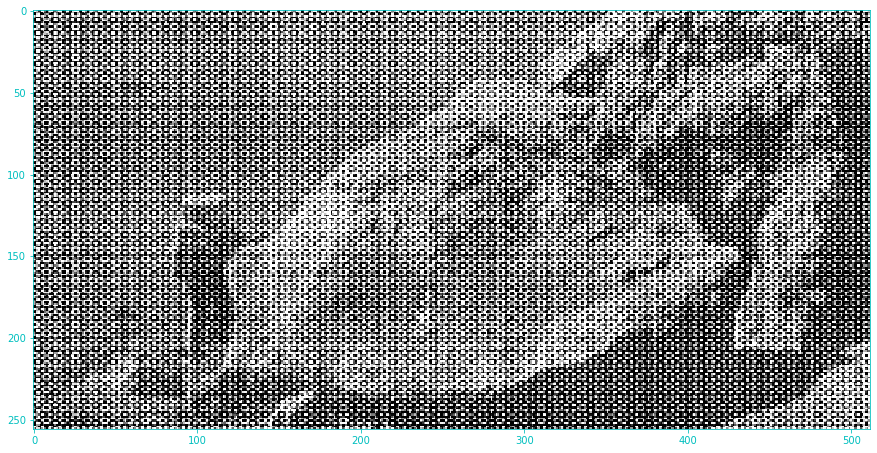

In [21]:
plt.figure(figsize=(15,10))
plt.imshow(moon, cmap='gray')
#plt.show()
plt.savefig('moon_org.png')

zachowany procent mocy =  74.55142518475914


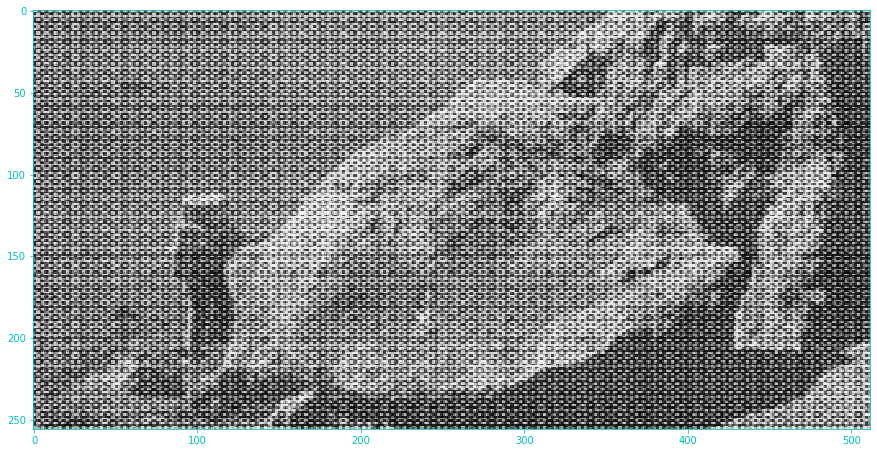

zachowany procent mocy =  65.30271447815548


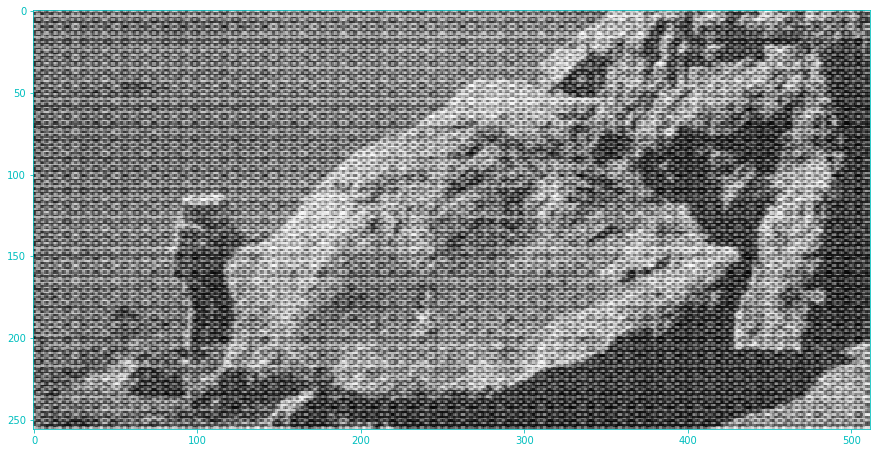

zachowany procent mocy =  60.82352187220964


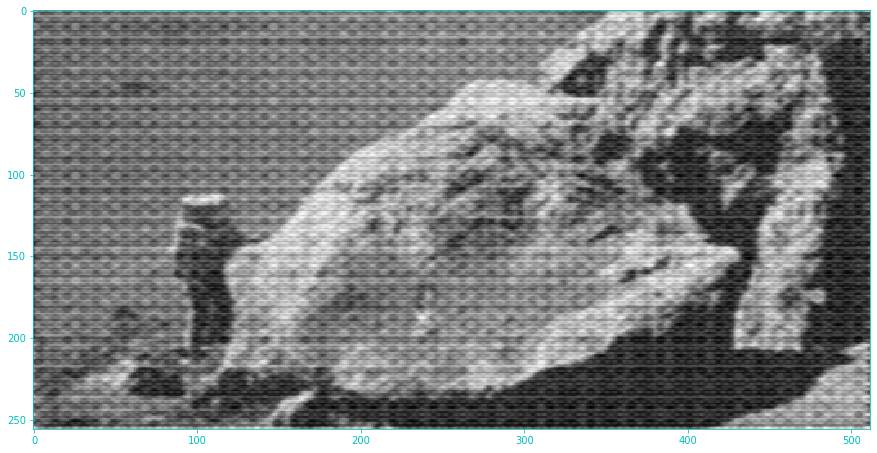

zachowany procent mocy =  59.9067585081985


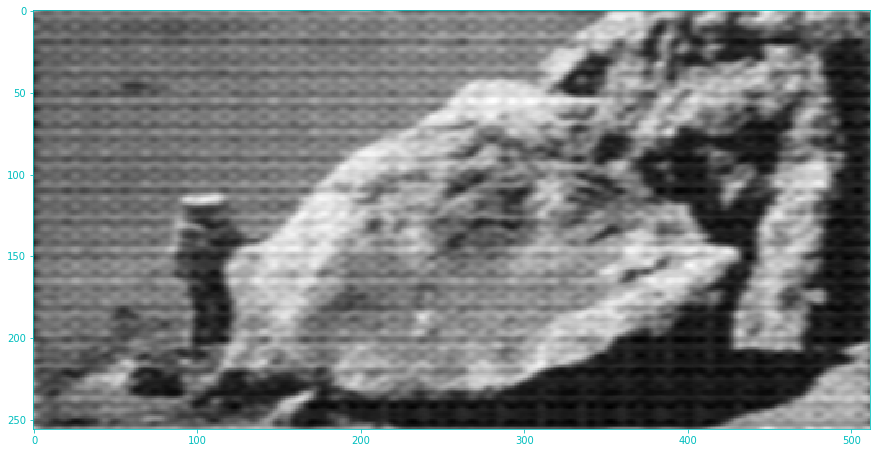

zachowany procent mocy =  59.5051923188898


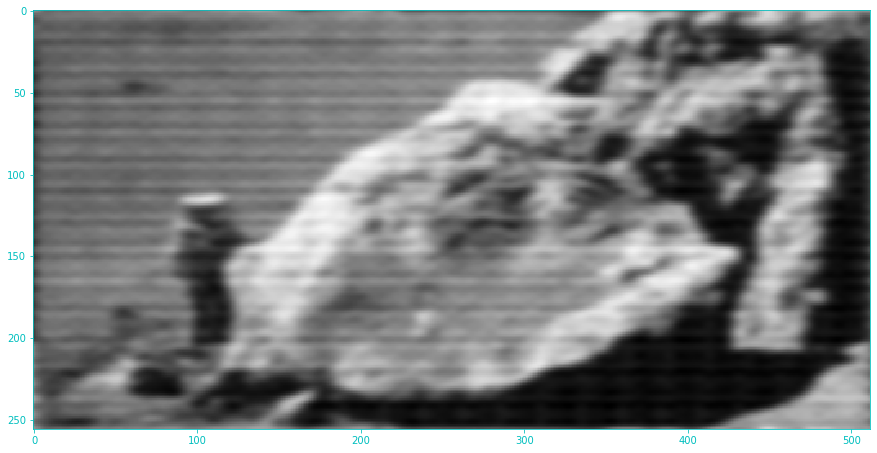

zachowany procent mocy =  58.84878523347628


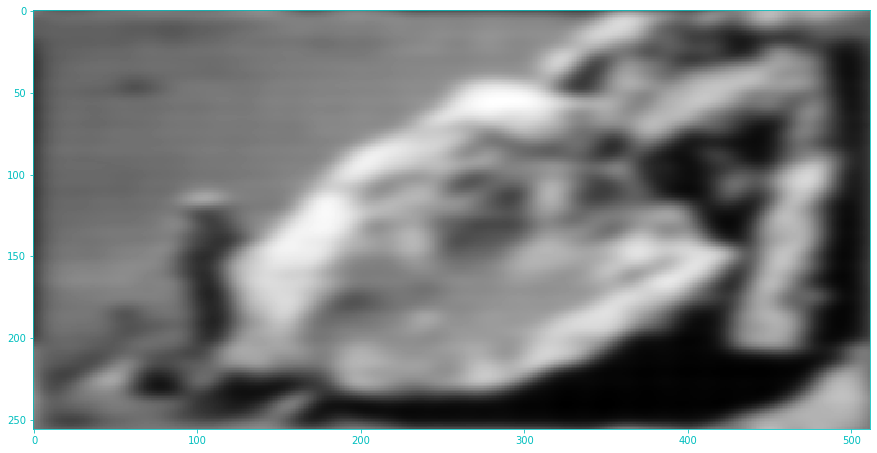

In [164]:
for i in [120,80,50,30,20,10]:
    filtering_choice(moon, 'gauss', i)

zachowany procent mocy =  60.4830640188614


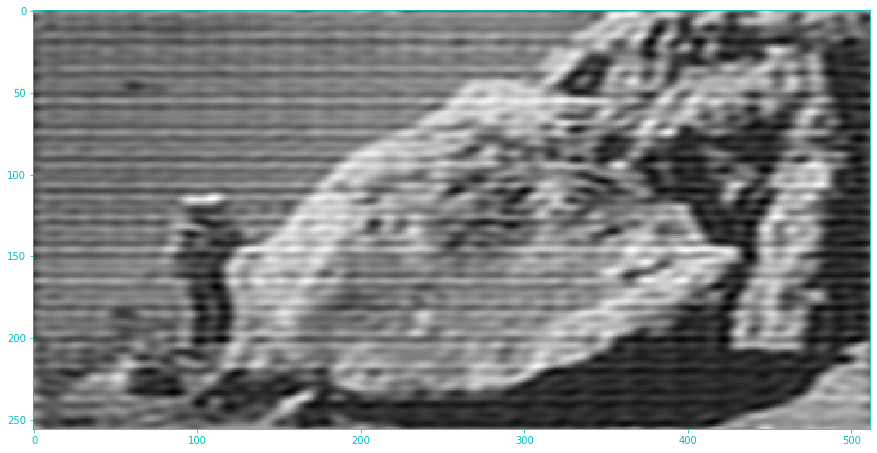

zachowany procent mocy =  60.68913645759153


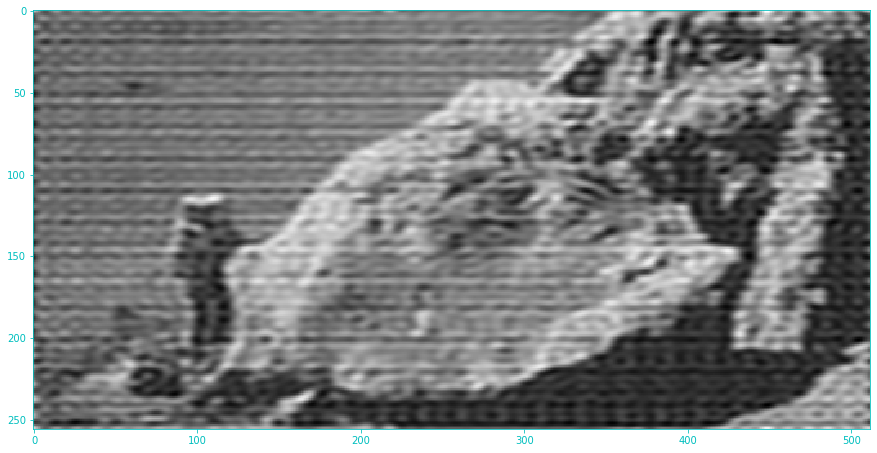

zachowany procent mocy =  61.27392981381992


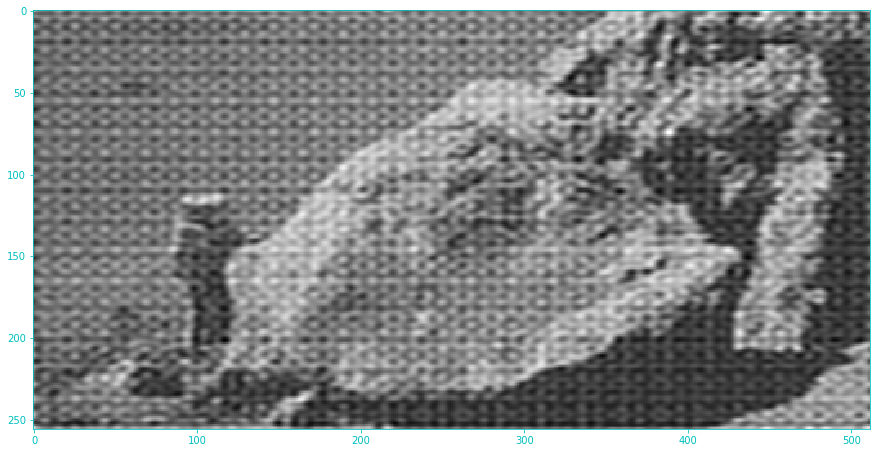

array([[160.96008724, 150.27243406, 138.97926555, ..., 159.32048039,
        166.81280367, 167.32226699],
       [118.2870503 , 113.30623764, 106.81569234, ..., 104.17721794,
        113.78729789, 118.88257348],
       [112.30194304, 111.78526328, 107.53809458, ...,  80.93659156,
         95.37800354, 106.81461897],
       ...,
       [124.73899718, 111.36118218,  98.64103989, ..., 134.98858515,
        138.55142956, 134.83937598],
       [181.55958144, 164.9087897 , 146.75189213, ..., 185.16677668,
        193.54781924, 192.18417374],
       [197.36168747, 181.80278979, 164.96804459, ..., 199.88144359,
        208.23821983, 207.23326313]])

In [165]:
filtering_choice(moon, 'low', 40)
filtering_choice(moon, 'low', 50)
filtering_choice(moon, 'low', 60)

zachowany procent mocy =  59.34523462970647


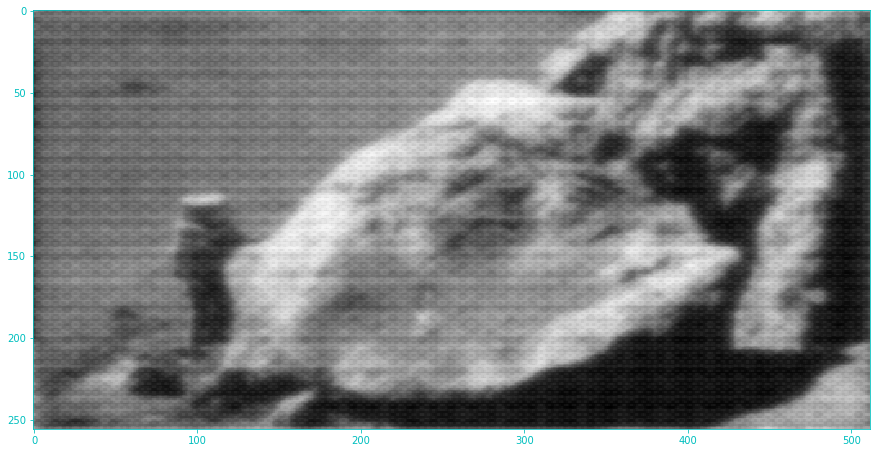

zachowany procent mocy =  59.817220643423575


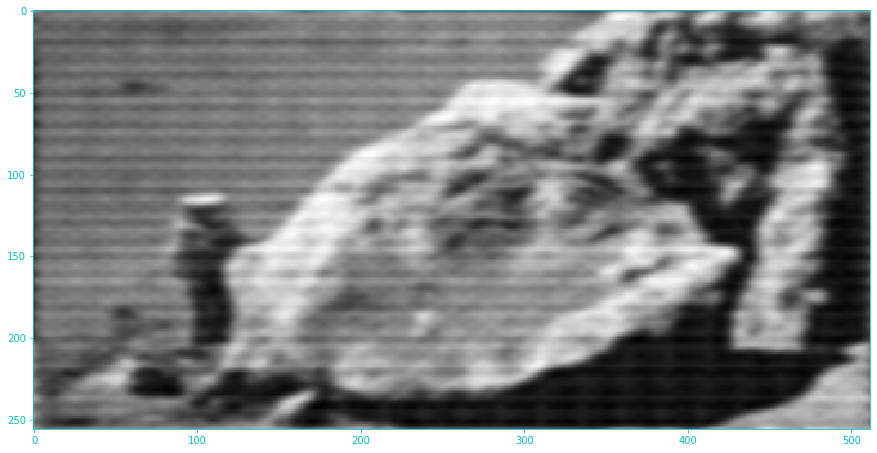

zachowany procent mocy =  60.2528589695955


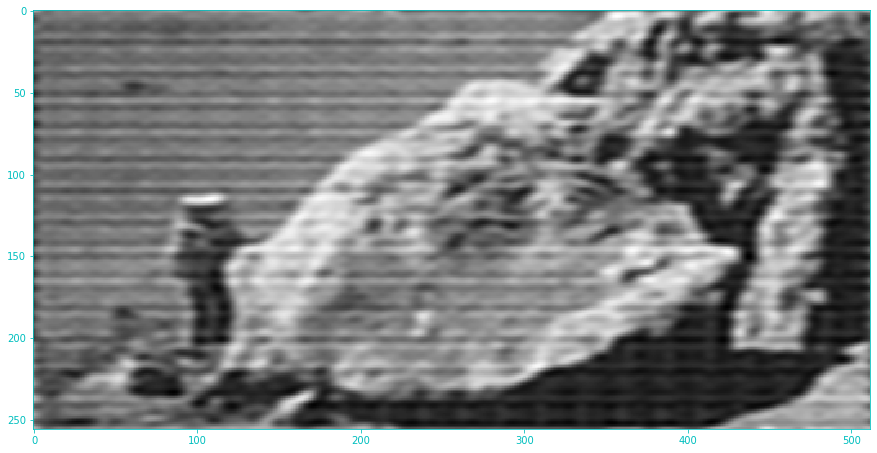

array([[146.29114592, 144.14879352, 140.40391435, ..., 143.24093686,
        145.49703076, 146.67910149],
       [129.81778386, 130.37189338, 129.57162357, ..., 123.11675541,
        125.63844042, 128.08885371],
       [113.11843736, 116.3593495 , 118.67362303, ..., 103.74117619,
        106.07946207, 109.4595207 ],
       ...,
       [127.85305497, 122.89388798, 117.5561528 , ..., 137.63215424,
        135.40831798, 132.10925649],
       [144.97607197, 139.97769335, 133.8666258 , ..., 150.49041258,
        150.26686219, 148.46283822],
       [152.98647978, 148.85945549, 143.18927112, ..., 154.14000648,
        155.48906702, 155.20868676]])

In [166]:
filtering_choice(moon, 'butter', 20,1)
filtering_choice(moon, 'butter', 27,2)
filtering_choice(moon, 'butter', 38,4)

zachowany procent mocy =  59.678016986247016


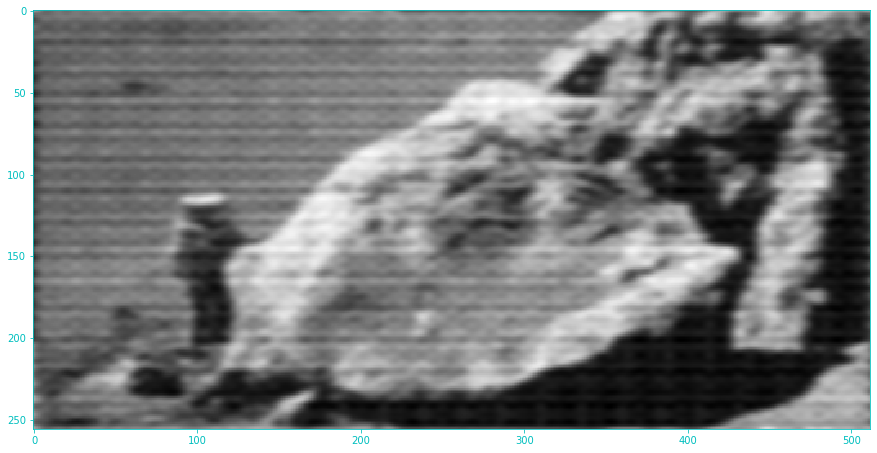

array([[136.40078276, 134.1575039 , 131.01258851, ..., 136.32320201,
        137.36062392, 137.47544333],
       [124.59052792, 124.31555185, 123.23619412, ..., 121.64447374,
        122.95122641, 124.06513426],
       [115.18735899, 116.76503361, 117.69495454, ..., 109.88900863,
        111.28540589, 113.22020604],
       ...,
       [124.79654227, 121.02510586, 117.16850737, ..., 133.26904946,
        131.10787447, 128.23469704],
       [136.90064135, 132.83460639, 128.14646371, ..., 142.41660858,
        141.7997803 , 139.96451495],
       [142.36523821, 138.70785436, 134.1646617 , ..., 145.12311502,
        145.59116191, 144.7192919 ]])

In [167]:
filtering_choice(moon, 'gauss', 24)

porównanie na takim samym R

zachowany procent mocy =  60.14472272005007


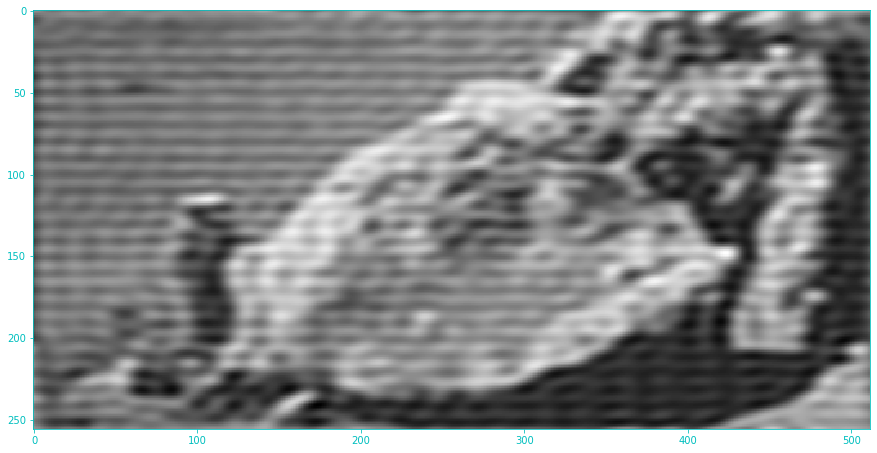

zachowany procent mocy =  59.916715717837036


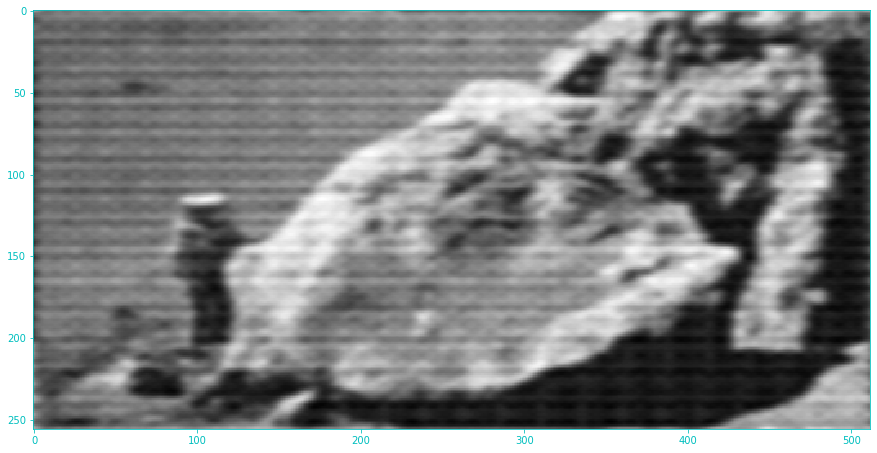

zachowany procent mocy =  59.9067585081985


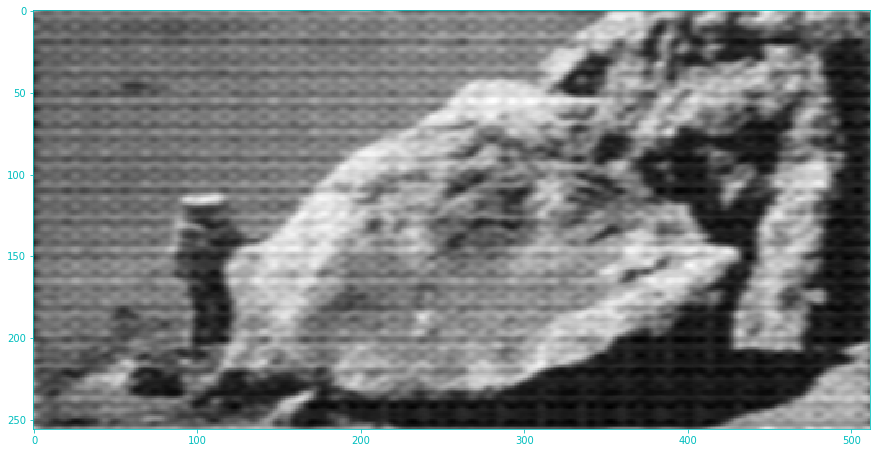

array([[143.63459966, 139.93328208, 134.9875098 , ..., 141.85523082,
        144.60213332, 145.30267372],
       [122.85330306, 122.81794349, 121.43152715, ..., 116.91231696,
        119.50188916, 121.64001485],
       [113.52091897, 116.42559152, 117.90456877, ..., 103.62763032,
        106.3530953 , 109.88724462],
       ...,
       [122.39962871, 118.39994247, 114.37005731, ..., 131.78209602,
        129.40081611, 126.16544982],
       [144.54130304, 138.52861494, 131.64461507, ..., 149.73542493,
        150.47879767, 148.73382071],
       [155.4800165 , 149.294907  , 141.94725416, ..., 157.44781195,
        159.83925937, 159.23766175]])

In [168]:
filtering_choice(moon, 'low', 30)
filtering_choice(moon, 'butter', 30,2)
filtering_choice(moon, 'gauss', 30)

wyświetlenie częstotliwości - porównanie

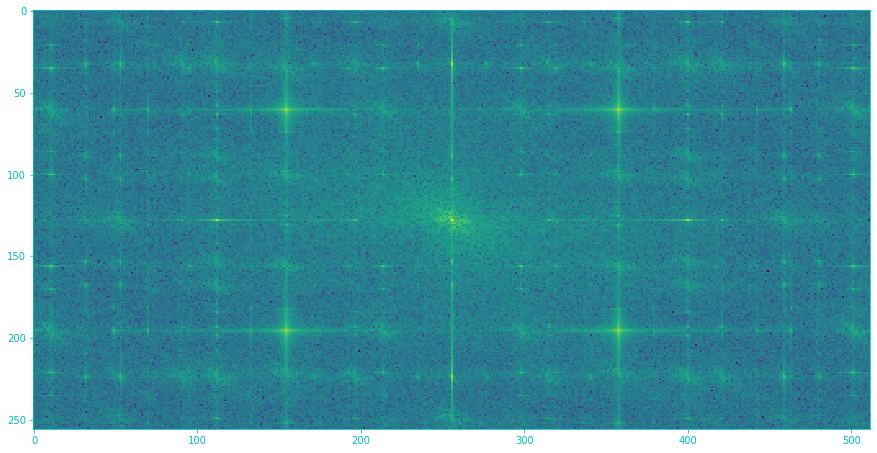

/home/oskar/.local/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == '':


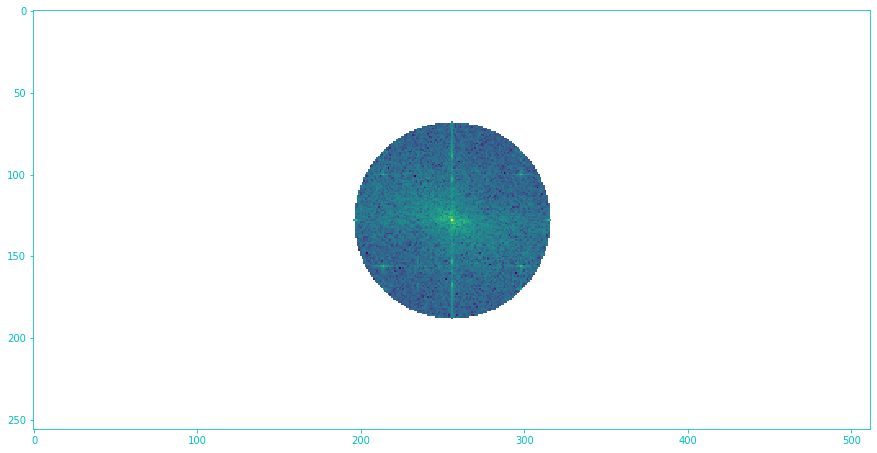

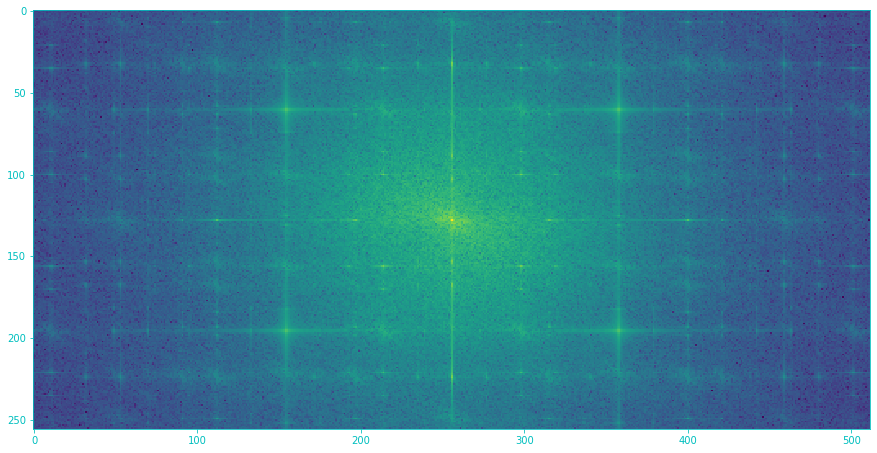

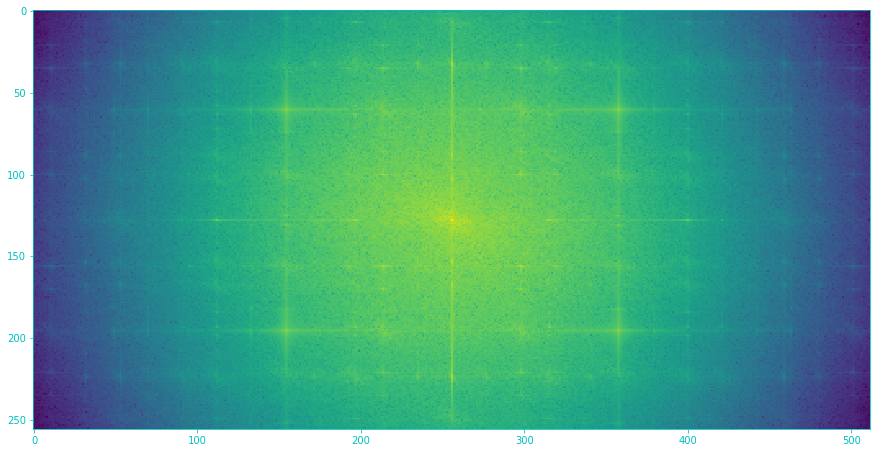

In [135]:
freq = fft2d(moon,0)
freq = shift(freq)
psd2D = np.abs( freq )**2 #moc spektrum
plt.figure(figsize=(15,10))
plt.imshow( np.log10( psd2D ))
plt.show()

ideal_low(freq,60)

psd2D = np.abs( freq )**2 #moc spektrum
plt.figure(figsize=(15,10))
plt.imshow( np.log10( psd2D ))
plt.show()

freq = fft2d(moon,0)
freq = shift(freq)

butterworth(freq,60,2)

psd2D = np.abs( freq )**2 #moc spektrum
plt.figure(figsize=(15,10))
plt.imshow( np.log10( psd2D ))
plt.show()


freq = fft2d(moon,0)
freq = shift(freq)
gaussian_low(freq,40)

psd2D = np.abs( freq )**2 #moc spektrum
plt.figure(figsize=(15,10))
plt.imshow( np.log10( psd2D ))
plt.show()



zjawisko ringingu

(256, 512)


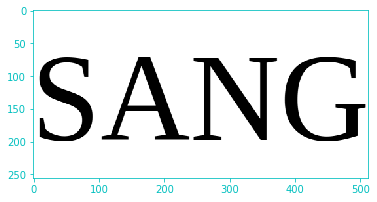

In [169]:
im33 = (Image.open('s44.png').convert('L')) # conert to greyscale
im33 = im33.crop((0,0,512,256))
im33 = np.array(im33)
print(im33.shape)
plt.imshow(im33, cmap='gray')
plt.show()

zachowany procent mocy =  97.62841640987044


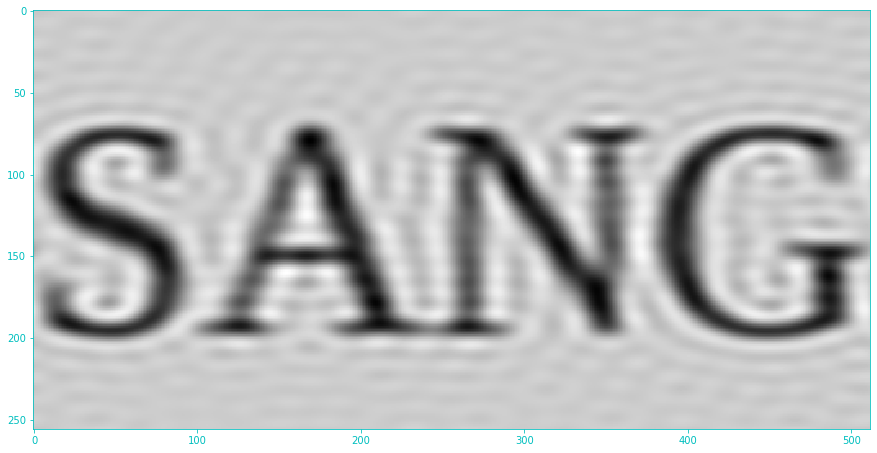

zachowany procent mocy =  95.89084591244624


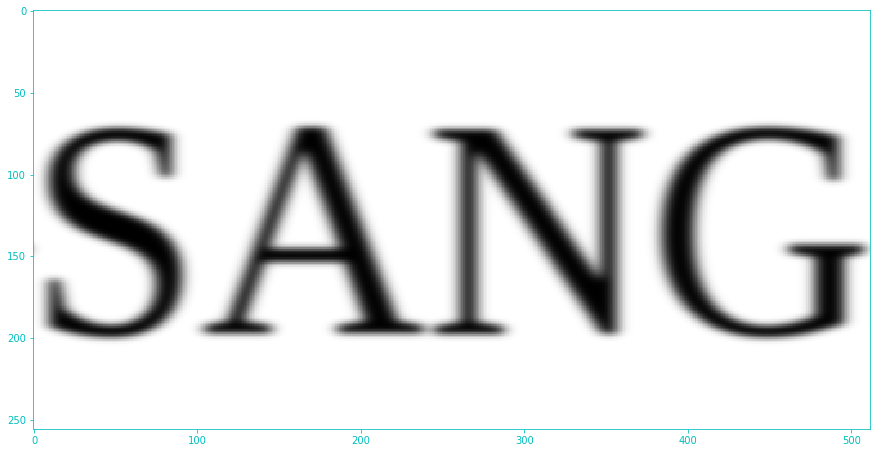

array([[255., 255., 255., ..., 255., 255., 255.],
       [255., 255., 255., ..., 255., 255., 255.],
       [255., 255., 255., ..., 255., 255., 255.],
       ...,
       [255., 255., 255., ..., 255., 255., 255.],
       [255., 255., 255., ..., 255., 255., 255.],
       [255., 255., 255., ..., 255., 255., 255.]])

In [170]:
filtering_choice(im33, 'low',20)
filtering_choice(im33, 'gauss',20)